In [1]:
import sys
import os
import subprocess
import tarfile
import shutil
import random
from functools import partial
from tqdm import tqdm
from tqdm.auto import tqdm
tqdm.pandas()

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import (random_split, DataLoader, TensorDataset, ConcatDataset)
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits import mplot3d
from Bio import motifs
import pickle
from datetime import datetime
import scipy.stats as stats
import math

import boda
from boda.common import constants, utils

boda_src = os.path.join( os.path.dirname( os.path.dirname( os.getcwd() ) ), 'src' )
sys.path.insert(0, boda_src)

from main import unpack_artifact, model_fn
from pymeme import streme, parse_streme_output

from torch.distributions.categorical import Categorical
from boda.generator.plot_tools import matrix_to_dms, ppm_to_IC, ppm_to_pwm, counts_to_ppm

import dmslogo
import palettable
import dmslogo.colorschemes
from dmslogo.colorschemes import CBPALETTE

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:98% !important; }</style>"))

In [2]:
if os.path.isdir('./artifacts'):
    shutil.rmtree('./artifacts')
hpo_rec = 'gs://syrgoth/aip_ui_test/model_artifacts__20211113_021200__287348.tar.gz'
unpack_artifact(hpo_rec)

model_dir = './artifacts'
model = model_fn(model_dir)
#model.cuda()
model.eval()
print('')

archive unpacked in ./


Loaded model from 20211113_021200 in eval mode



In [3]:
class mpra_predictor(nn.Module):
    def __init__(self,
                 model,
                 pred_idx=0,
                 ini_in_len=200,
                 model_in_len=600,
                 cat_axis=-1):
        super().__init__()
        self.model = model
        self.pred_idx = pred_idx
        self.ini_in_len = ini_in_len 
        self.model_in_len = model_in_len
        self.cat_axis = cat_axis       
        
        try: self.model.eval()
        except: pass
        
        self.register_flanks()
    
    def forward(self, x):
        pieces = [self.left_flank.repeat(x.shape[0], 1, 1), x, self.right_flank.repeat(x.shape[0], 1, 1)]
        in_tensor = torch.cat( pieces, axis=self.cat_axis)
        out_tensor = self.model(in_tensor)[:, self.pred_idx]
        return out_tensor
    
    def register_flanks(self):
        missing_len = self.model_in_len - self.ini_in_len
        left_idx = - missing_len//2 + missing_len%2
        right_idx = missing_len//2 + missing_len%2
        left_flank = utils.dna2tensor(constants.MPRA_UPSTREAM[left_idx:]).unsqueeze(0)
        right_flank = utils.dna2tensor(constants.MPRA_DOWNSTREAM[:right_idx]).unsqueeze(0)         
        self.register_buffer('left_flank', left_flank)
        self.register_buffer('right_flank', right_flank) 

        
def df_to_onehot_tensor(in_df, seq_column='sequence'):
    onehot_sequences = torch.stack([utils.dna2tensor(subsequence) \
                                for subsequence in tqdm(in_df[seq_column])])
    return onehot_sequences

def fasta_to_tensor(file_name):
    fasta_dict = {}
    with open(file_name, 'r') as f:
        for line in f:
            line_str = str(line)
            if line_str[0] == '>':
                my_id = line_str.lstrip('>').rstrip('\n')
                fasta_dict[my_id] = ''
            else:
                fasta_dict[my_id] += line_str.rstrip('\n')
    seq_tensors = []
    for sequence in list(fasta_dict.values()):
        seq_tensors.append(utils.dna2tensor(sequence))
    return torch.stack(seq_tensors, dim=0)

def dna2tensor_approx(sequence_str, vocab_list=constants.STANDARD_NT, N_value=0.25):
    seq_tensor = np.zeros((len(vocab_list), len(sequence_str)))
    for letterIdx, letter in enumerate(sequence_str):
        try:
            seq_tensor[vocab_list.index(letter), letterIdx] = 1
        except:
            seq_tensor[:, letterIdx] = N_value
    seq_tensor = torch.Tensor(seq_tensor)
    return seq_tensor

def frame_print(string, marker='*', left_space=25):
    left_spacer = left_space * ' '
    string = marker + ' ' + string.upper() + ' ' + marker
    n = len(string)
    print('', flush=True)
    print('', flush=True)
    print(left_spacer + n * marker, flush=True)
    print(left_spacer + string, flush=True)
    print(left_spacer + n * marker, flush=True)
    print('', flush=True)
    print('', flush=True)
    
def decor_print(string):
    decor = 15*'-'
    print('', flush=True)
    print(decor + ' ' + string + ' ' + decor, flush=True)
    print('', flush=True)

    
def isg_contributions(sequences,
                      predictor,
                      num_steps=50,
                      num_samples=20,
                      eval_batch_size=1024,
                      theta_factor=15):
    
    batch_size = eval_batch_size // num_samples
    temp_dataset = TensorDataset(sequences)
    temp_dataloader = DataLoader(temp_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

    all_salient_maps = []
    all_gradients = []
    for local_batch in tqdm(temp_dataloader):
        target_thetas = (theta_factor * local_batch[0].cuda()).requires_grad_()
        #base_thetas = theta_factor / 3 * torch.ones_like(target_thetas)
        line_gradients = []
        for i in range(0, num_steps + 1):
            point_thetas = (i / num_steps * target_thetas)
            #point_thetas = base_thetas + i / num_steps * (target_thetas - base_thetas)
            point_distributions = F.softmax(point_thetas, dim=-2)

            nucleotide_probs = Categorical(torch.transpose(point_distributions, -2, -1))
            sampled_idxs = nucleotide_probs.sample((num_samples, ))
            sampled_nucleotides_T = F.one_hot(sampled_idxs, num_classes=4)
            sampled_nucleotides = torch.transpose(sampled_nucleotides_T, -2, -1)
            distribution_repeater = point_distributions.repeat(num_samples, *[1 for i in range(3)])
            sampled_nucleotides = sampled_nucleotides - distribution_repeater.detach() + distribution_repeater 
            samples = sampled_nucleotides.flatten(0,1)

            preds = predictor(samples)
            point_predictions = preds.unflatten(0, (num_samples, target_thetas.shape[0])).mean(dim=0)
            point_gradients = torch.autograd.grad(point_predictions.sum(), inputs=point_thetas, retain_graph=True)[0]
            line_gradients.append(point_gradients)
            
        gradients = torch.stack(line_gradients).mean(dim=0).detach()
        all_salient_maps.append(gradients * target_thetas)
        all_gradients.append(gradients)
    return torch.cat(all_salient_maps), theta_factor * torch.cat(all_gradients)

### Parse MPRA data

In [4]:
satmut_df = pd.read_csv('gs://syrgoth/data/saturation_mutagenesis/DNM_sknsh_with_seqs.txt', sep='\t')

In [5]:
#filters
df_temp = satmut_df[(satmut_df.Project != 'negCtrl') &  (satmut_df.Project != 'posCtrl')].reset_index(drop=True)

In [6]:
regions = [snp for snp in sorted(set(df_temp.SNP)) if '-' in snp]
regions

['chr14:29859932-29860132',
 'chr14:37559109-37559309',
 'chr14:57553315-57553515',
 'chr17:2095085-2095285',
 'chr17:2095258-2095458',
 'chr19:30843409-30843609',
 'chr1:47041104-47041304',
 'chr1:87795605-87795805',
 'chr1:90847872-90848072',
 'chr2:60077721-60077921',
 'chr3:136760181-136760381',
 'chr3:19028436-19028636',
 'chr4:147215670-147215870',
 'chr5:87852766-87852966',
 'chr6:136595273-136595473',
 'chr6:14501550-14501750',
 'chr6:91342117-91342317',
 'chr7:100480515-100480715',
 'chr7:114999468-114999668',
 'chr7:114999561-114999761']

In [7]:
#MPRA effects
effect_tensor_dict = {}
for region in regions:
    region_df = df_temp[(df_temp.SNP == region) & (df_temp.strand == 'fwd')]
    ref_sequence_df = region_df[region_df['Row.names'] == region_df['SNP']]
    if len(ref_sequence_df) == 1:
        num_variants = len(set(region_df['Row.names'])) - 1
        ref_id = ref_sequence_df['Row.names'].values[0]
        ref_sequence = ref_sequence_df['nt_sequence'].values[0]
        ref_lfc = float(ref_sequence_df['log2FoldChange'])
        ref_lfcSE = float(ref_sequence_df['lfcSE'])

        effect_tensor = torch.zeros((4, len(ref_sequence)))
        lfcSE_tensor = torch.zeros((4, len(ref_sequence)))
        for idx, row in region_df.iterrows():
            alt_id = row['Row.names']
            if alt_id != ref_id:
                mutation_info = alt_id.split(':')[-1]
                ref_base = mutation_info[0]
                alt_base = mutation_info[-1]
                site_idx = int(mutation_info[1:-1]) - 1        
                alt_lfc = row['log2FoldChange']
                alt_lfcSE = row['lfcSE']
                effect_tensor[constants.STANDARD_NT.index(alt_base), site_idx] = alt_lfc - ref_lfc
                lfcSE_tensor[constants.STANDARD_NT.index(alt_base), site_idx] = alt_lfcSE
        effect_tensor_dict[region] = {'ref_sequence': ref_sequence,
                                      'ref_lfc': ref_lfc,
                                      'ref_lfcSE': ref_lfcSE,
                                      'mpra_effect': effect_tensor,
                                      'num_mpra_alts': num_variants,
                                      'lfcSE_tensor': lfcSE_tensor
                                     }

In [8]:
#Contribution effects
batch_tensor = torch.stack([utils.dna2tensor(dicti['ref_sequence']) for dicti in effect_tensor_dict.values()])

In [9]:
eval_batch_size = 1040
cell_type = 2

predictor = mpra_predictor(model=model, pred_idx=cell_type).cuda()

In [10]:
salient_maps, extended_contributions = isg_contributions(batch_tensor, predictor, eval_batch_size=eval_batch_size)
salient_maps, extended_contributions = salient_maps.cpu(), extended_contributions.cpu()

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/torch/nn/functional.py:652: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool1d(input, kernel_size, stride, padding, dilation, ceil_mode)


In [11]:
ref_predictions = predictor(batch_tensor.cuda()).detach().cpu()

In [12]:
all_ref_sequences = [dicti['ref_sequence'] for dicti in effect_tensor_dict.values()]

predicted_saturations = []
for sequence_as_string in tqdm(all_ref_sequences):
    combinations = []
    for idx in range(len(sequence_as_string)):
        four_combinations = torch.stack([utils.dna2tensor(sequence_as_string[:idx] + base + sequence_as_string[idx+1:]) for base in constants.STANDARD_NT])
        combinations.append(four_combinations)
    combinations = torch.stack(combinations).flatten(0,1)
    
    ref_tensor = utils.dna2tensor(sequence_as_string)
    base_prediction = predictor(ref_tensor.view(1,4,-1).cuda()).detach().cpu()
    sat_preds = predictor(combinations.cuda()).detach().cpu()
    
    out_tensor = (sat_preds.unflatten(0, (200, 4)).T - base_prediction) * (torch.ones_like(ref_tensor) - ref_tensor)
    predicted_saturations.append(out_tensor)
    
#predicted_saturations = torch.stack(predicted_saturations)

  0%|          | 0/19 [00:00<?, ?it/s]


--------------- chr14:29859932-29860132 ---------------

In-vitro mutagenesis | ref_lfc: 0.7349, ref_lfcSE: 0.0918 |


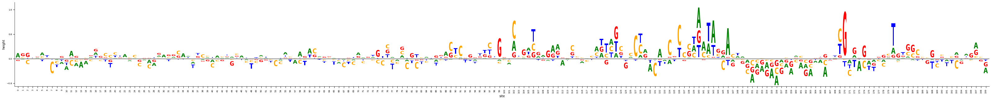

In-silico mutagenesis | pred_lfc: 1.0003 |


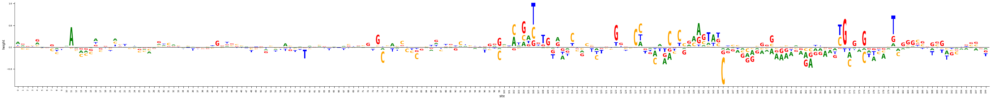

Variant contributions


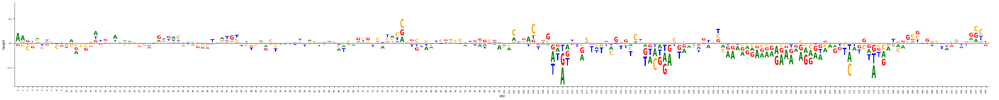


--------------- chr14:37559109-37559309 ---------------

In-vitro mutagenesis | ref_lfc: -0.2037, ref_lfcSE: 0.0615 |


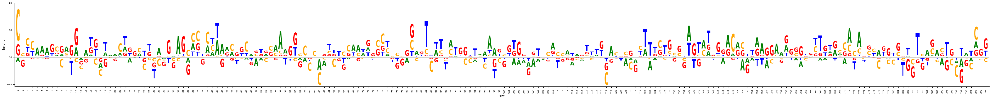

In-silico mutagenesis | pred_lfc: -0.1531 |


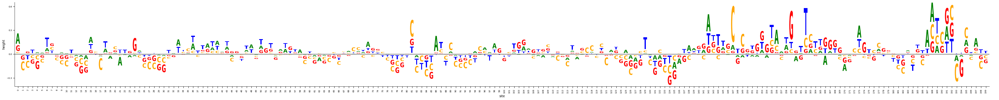

Variant contributions


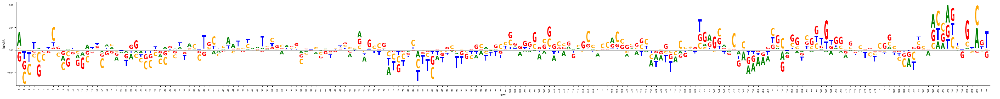


--------------- chr14:57553315-57553515 ---------------

In-vitro mutagenesis | ref_lfc: 0.8462, ref_lfcSE: 0.1354 |


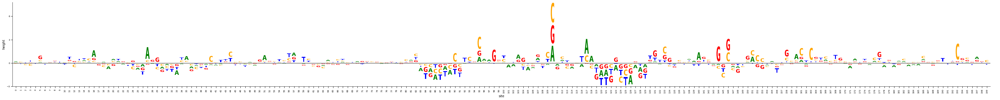

In-silico mutagenesis | pred_lfc: 1.5192 |


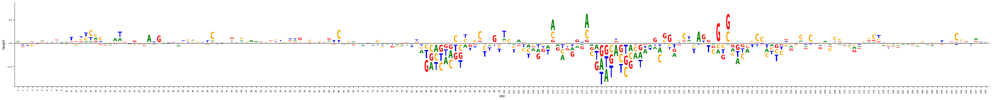

Variant contributions


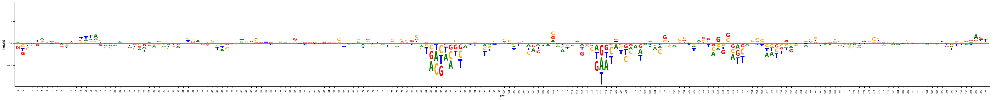


--------------- chr17:2095085-2095285 ---------------

In-vitro mutagenesis | ref_lfc: 1.2781, ref_lfcSE: 0.0712 |


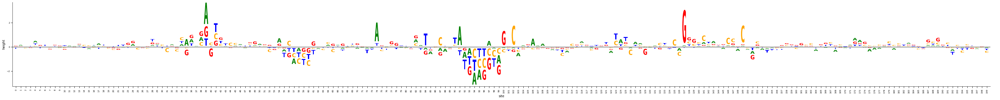

In-silico mutagenesis | pred_lfc: 0.894 |


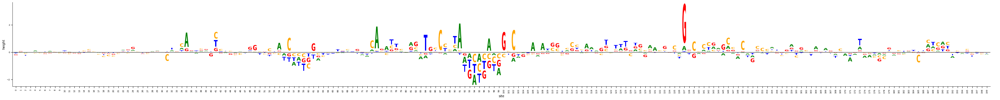

Variant contributions


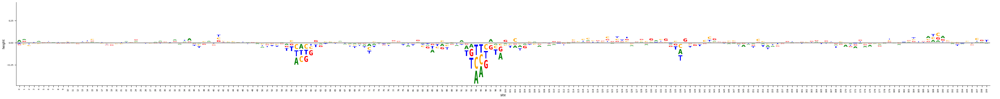


--------------- chr17:2095258-2095458 ---------------

In-vitro mutagenesis | ref_lfc: 1.9521, ref_lfcSE: 0.0806 |


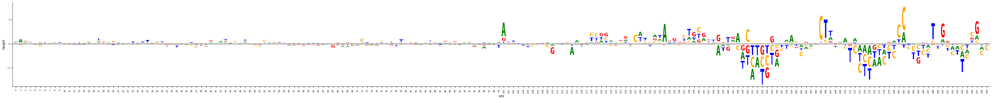

In-silico mutagenesis | pred_lfc: 1.7146 |


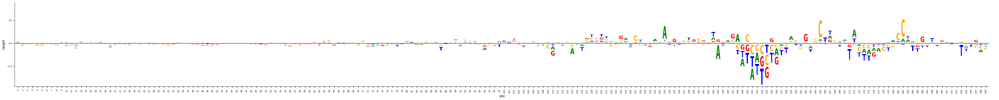

Variant contributions


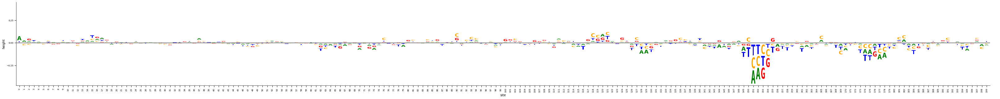


--------------- chr19:30843409-30843609 ---------------

In-vitro mutagenesis | ref_lfc: 0.2133, ref_lfcSE: 0.1441 |


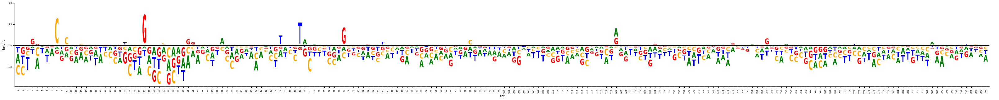

In-silico mutagenesis | pred_lfc: -0.2243 |


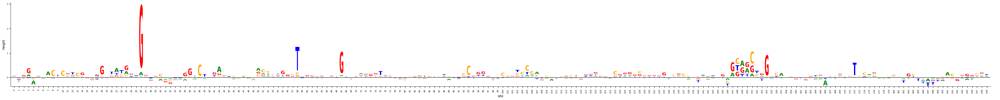

Variant contributions


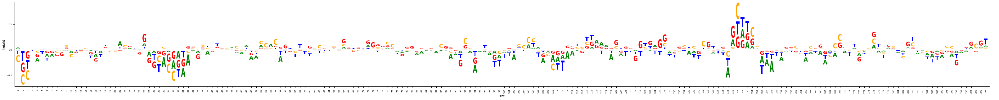


--------------- chr1:47041104-47041304 ---------------

In-vitro mutagenesis | ref_lfc: 0.3866, ref_lfcSE: 0.2172 |


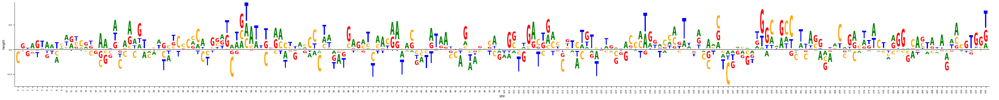

In-silico mutagenesis | pred_lfc: 1.031 |


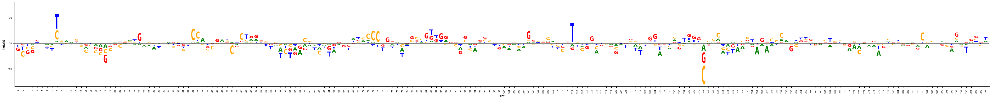

Variant contributions


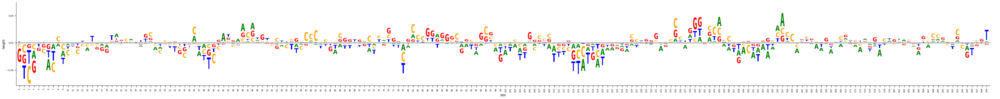


--------------- chr1:90847872-90848072 ---------------

In-vitro mutagenesis | ref_lfc: -0.0841, ref_lfcSE: 0.0918 |


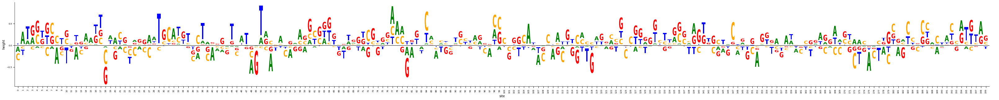

In-silico mutagenesis | pred_lfc: -0.1275 |


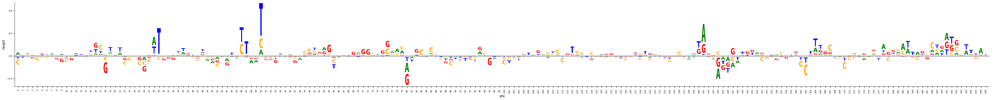

Variant contributions


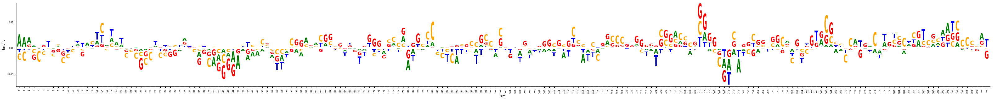


--------------- chr2:60077721-60077921 ---------------

In-vitro mutagenesis | ref_lfc: -0.5163, ref_lfcSE: 0.068 |


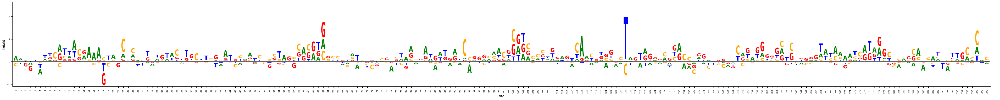

In-silico mutagenesis | pred_lfc: -0.3823 |


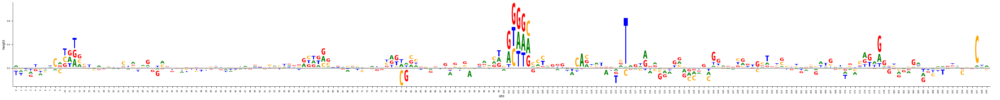

Variant contributions


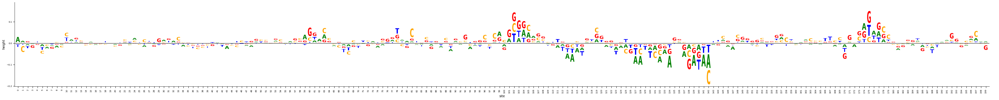


--------------- chr3:136760181-136760381 ---------------

In-vitro mutagenesis | ref_lfc: 0.195, ref_lfcSE: 0.1069 |


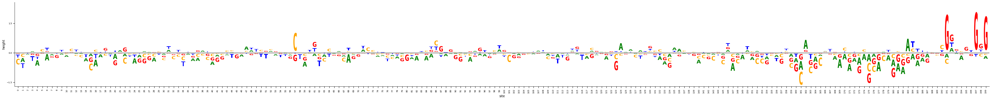

In-silico mutagenesis | pred_lfc: 0.3062 |


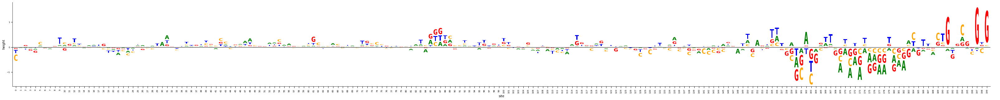

Variant contributions


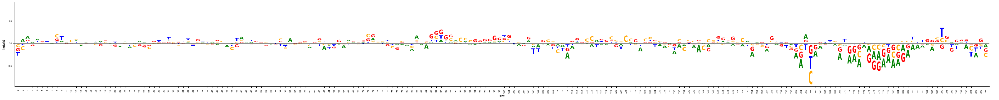


--------------- chr3:19028436-19028636 ---------------

In-vitro mutagenesis | ref_lfc: 0.4588, ref_lfcSE: 0.1109 |


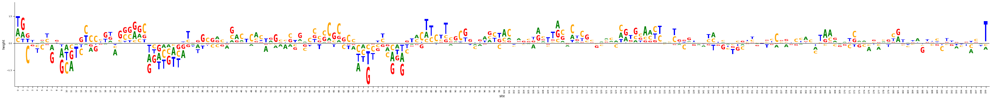

In-silico mutagenesis | pred_lfc: 0.6211 |


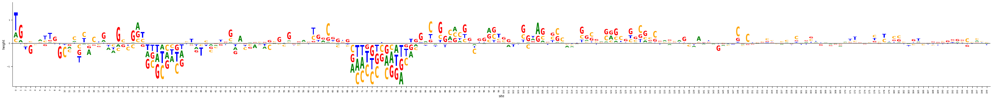

Variant contributions


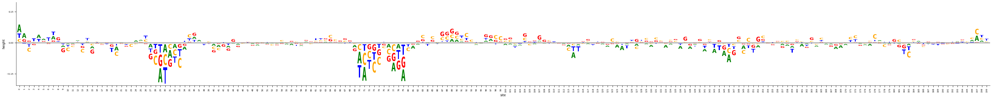


--------------- chr4:147215670-147215870 ---------------

In-vitro mutagenesis | ref_lfc: -0.6131, ref_lfcSE: 1.2738 |


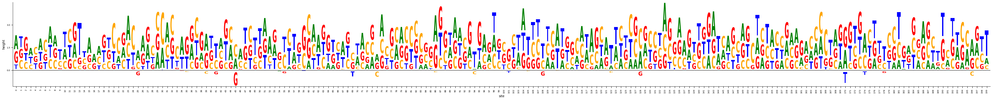

In-silico mutagenesis | pred_lfc: 0.7439 |


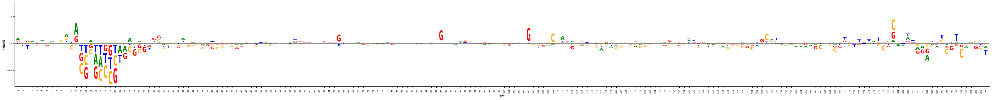

Variant contributions


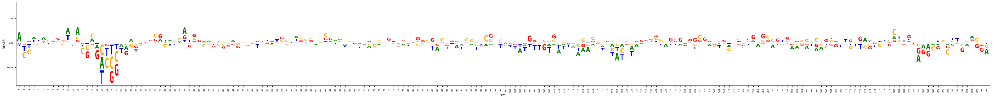


--------------- chr5:87852766-87852966 ---------------

In-vitro mutagenesis | ref_lfc: 0.3435, ref_lfcSE: 0.1754 |


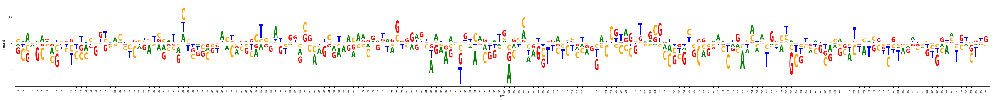

In-silico mutagenesis | pred_lfc: 0.5612 |


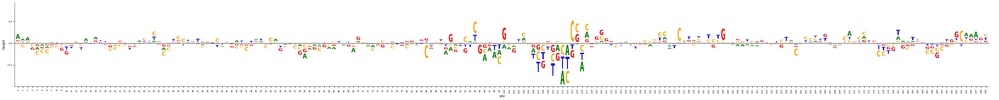

Variant contributions


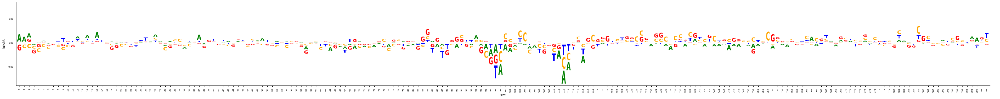


--------------- chr6:136595273-136595473 ---------------

In-vitro mutagenesis | ref_lfc: 1.0814, ref_lfcSE: 0.9527 |


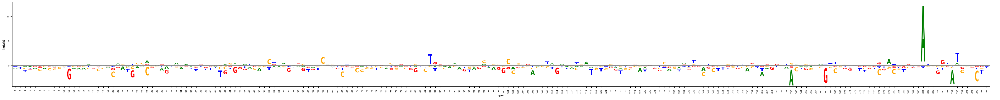

In-silico mutagenesis | pred_lfc: 1.0296 |


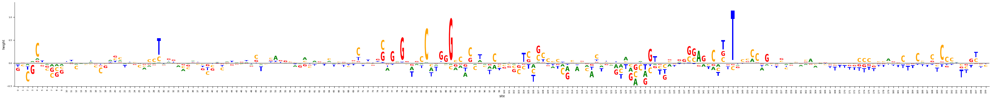

Variant contributions


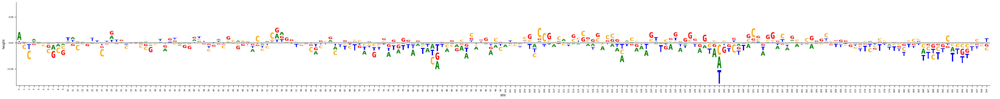


--------------- chr6:14501550-14501750 ---------------

In-vitro mutagenesis | ref_lfc: 1.6493, ref_lfcSE: 0.0976 |


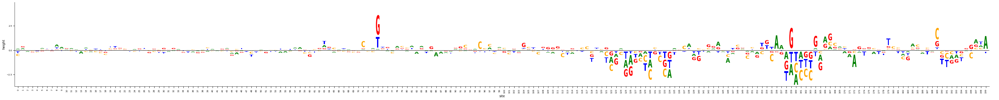

In-silico mutagenesis | pred_lfc: 1.1204 |


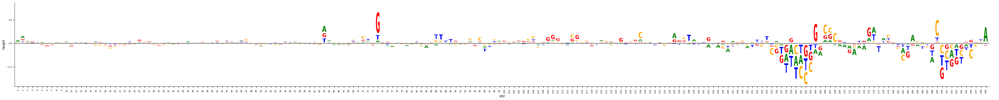

Variant contributions


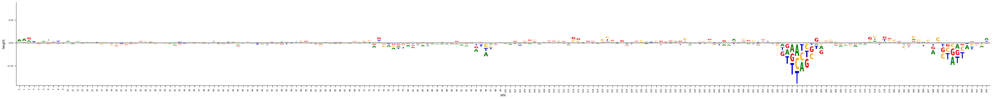


--------------- chr6:91342117-91342317 ---------------

In-vitro mutagenesis | ref_lfc: 0.7317, ref_lfcSE: 0.0809 |


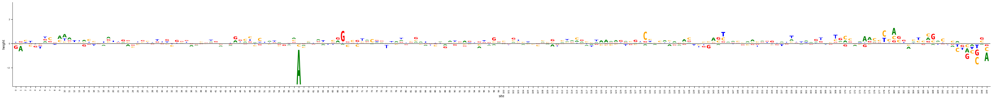

In-silico mutagenesis | pred_lfc: 0.6972 |


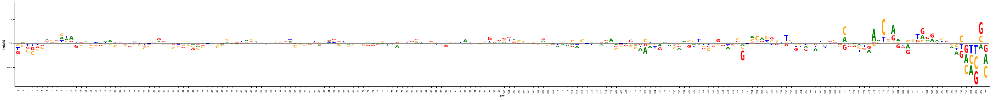

Variant contributions


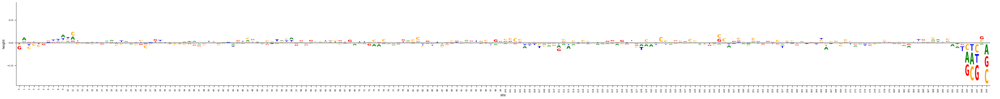


--------------- chr7:100480515-100480715 ---------------

In-vitro mutagenesis | ref_lfc: 0.8965, ref_lfcSE: 0.0773 |


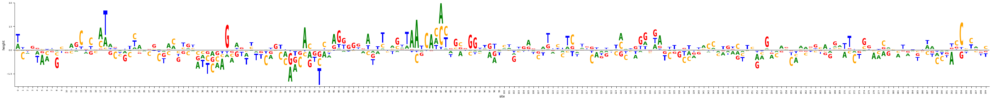

In-silico mutagenesis | pred_lfc: 1.2008 |


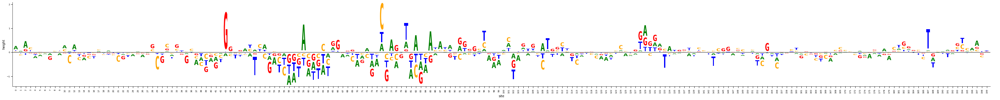

Variant contributions


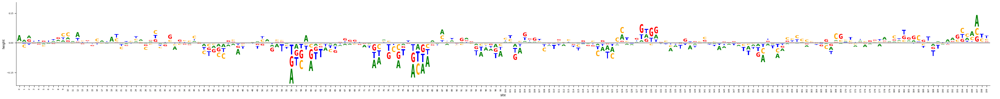


--------------- chr7:114999468-114999668 ---------------

In-vitro mutagenesis | ref_lfc: -0.0764, ref_lfcSE: 0.098 |


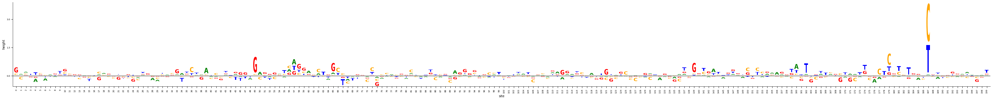

In-silico mutagenesis | pred_lfc: 0.3768 |


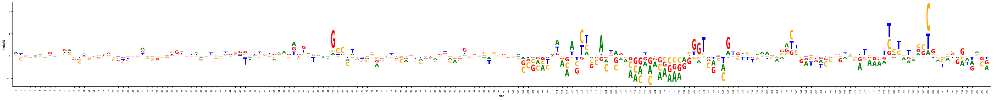

Variant contributions


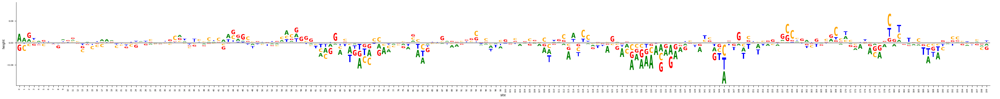


--------------- chr7:114999561-114999761 ---------------

In-vitro mutagenesis | ref_lfc: 1.362, ref_lfcSE: 0.0919 |


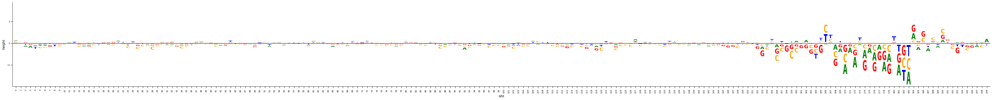

In-silico mutagenesis | pred_lfc: 0.2697 |


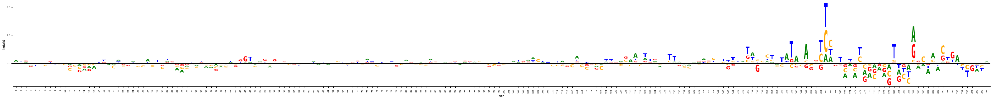

Variant contributions


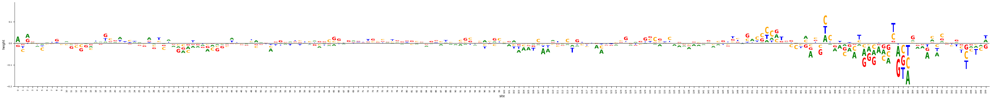

In [327]:
idx_count = 0
for key in effect_tensor_dict.keys():
    decor_print(key)
    ref_lfc = effect_tensor_dict[key]['ref_lfc']
    ref_lfcSE = effect_tensor_dict[key]['ref_lfcSE']
    num_variants = effect_tensor_dict[key]['num_mpra_alts']
    print(f'In-vitro mutagenesis | ref_lfc: {round(ref_lfc, 4)}, ref_lfcSE: {round(ref_lfcSE, 4)} |')
    matrix = effect_tensor_dict[key]['mpra_effect'].view(4,-1)
    y_max = float(matrix.abs().sum(dim=0).max())
    fig, ax = matrix_to_dms(matrix, y_max=y_max, fontaspect=.65, widthscale=0.8,
                      axisfontscale=0.6, heightscale=2)
    plt.show()

    ref_tensor = batch_tensor[idx_count,...]
    ref_prediction = float(ref_predictions[idx_count,...])
    
    print(f'In-silico mutagenesis | pred_lfc: {round(ref_prediction, 4)} |')
    matrix = predicted_saturations[idx_count].view(4,-1)
    y_max = float(matrix.abs().sum(dim=0).max())
    fig, ax = matrix_to_dms(matrix, y_max=y_max, fontaspect=.65, widthscale=0.8,
                      axisfontscale=0.6, heightscale=2)
    plt.show()
    
    print(f'Variant contributions')
    effect_tensor = (torch.ones_like(ref_tensor) - ref_tensor) * extended_contributions[idx_count,...]
    matrix = effect_tensor.view(4,-1)
    y_max = float(matrix.abs().sum(dim=0).max())
    fig, ax = matrix_to_dms(matrix, y_max=y_max, fontaspect=.65, widthscale=0.8,
                      axisfontscale=0.6, heightscale=2)
    plt.show()
    
    
    
    idx_count += 1

In [29]:
def plot_variant_effects(effect_array, colors=['g', 'y', 'r', 'b'], figsize=(50,5), stem_offset=0.0,
                         marker_alpha=0.5, stem_alpha=0.5, linestyle='solid', ax=None):
    markerfmts = [color + 'o' for color in colors]
    locs = np.arange(0, effect_array.shape[1])
    plt.figure(figsize=figsize)
    
    offset = 0
    for i in range(4):
        heads = np.array(effect_array[i,:], copy=True)
        heads[heads == 0.] = np.nan
        #markerline, stemlines, baseline = plt.stem(locs + offset, heads, colors[i], markerfmt=markerfmts[i])
        markerline, stemlines, baseline = plt.stem(locs + offset, heads, 'k', markerfmt=markerfmts[i])
        plt.setp(stemlines, 'linestyle', linestyle)
        plt.setp(stemlines, 'alpha', stem_alpha)
        plt.setp(markerline, 'alpha', marker_alpha)
        plt.setp(baseline, 'color', 'k')
        plt.setp(baseline, 'alpha', 0.2)
        plt.setp(baseline, 'linestyle', 'dashed')
        
        offset += stem_offset
    plt.margins(x=0.0075)
    return markerline, stemlines, baseline

def plot_mean_effect(effect_array, figsize=(50,5), color='k', markerfmt=','):
    sum_effects =  - effect_array.sum(axis=0)
    plt.figure(figsize=figsize)
    locs = np.arange(0, len(sum_effects))
    markerline, stemlines, baseline = plt.stem(locs, sum_effects, color, markerfmt=markerfmt)


--------------- chr14:29859932-29860132 ---------------

In-vitro mutagenesis | ref_lfc: 0.7349, ref_lfcSE: 0.0918 |


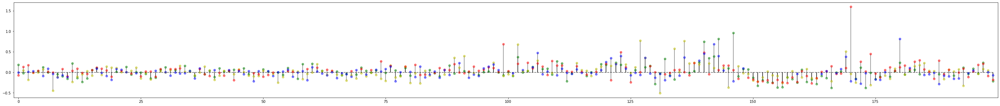

In-silico mutagenesis | pred_lfc: 1.0003 |


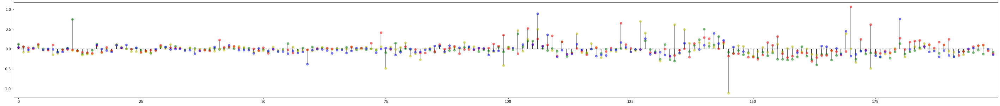

Variant contribution scores


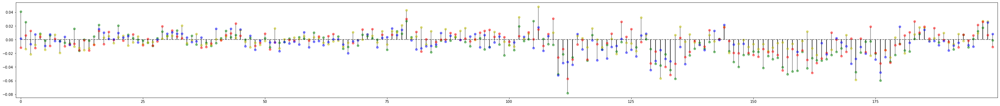



--------------- chr14:37559109-37559309 ---------------

In-vitro mutagenesis | ref_lfc: -0.2037, ref_lfcSE: 0.0615 |


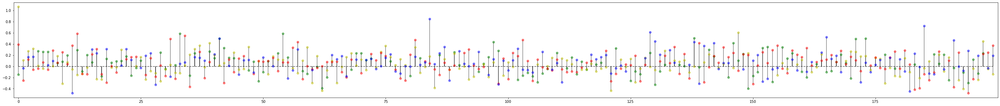

In-silico mutagenesis | pred_lfc: -0.1531 |


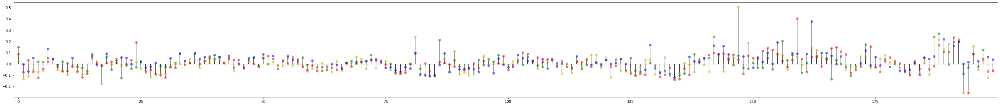

Variant contribution scores


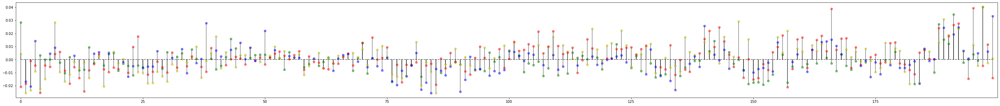



--------------- chr14:57553315-57553515 ---------------

In-vitro mutagenesis | ref_lfc: 0.8462, ref_lfcSE: 0.1354 |


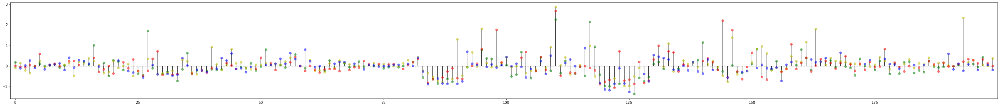

In-silico mutagenesis | pred_lfc: 1.5192 |


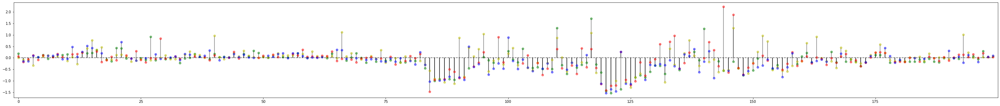

Variant contribution scores


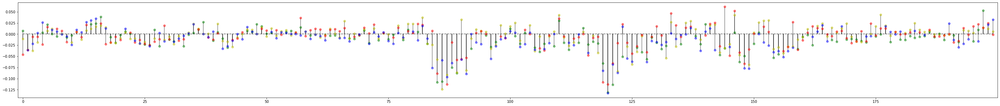



--------------- chr17:2095085-2095285 ---------------

In-vitro mutagenesis | ref_lfc: 1.2781, ref_lfcSE: 0.0712 |


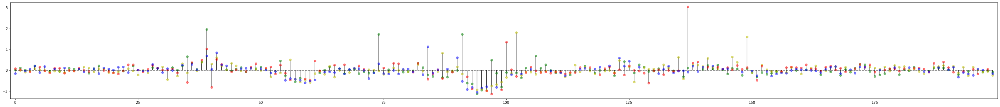

In-silico mutagenesis | pred_lfc: 0.894 |


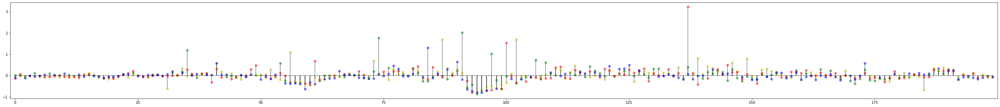

Variant contribution scores


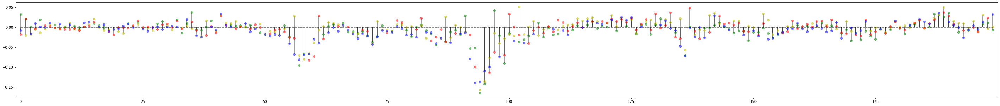



--------------- chr17:2095258-2095458 ---------------

In-vitro mutagenesis | ref_lfc: 1.9521, ref_lfcSE: 0.0806 |


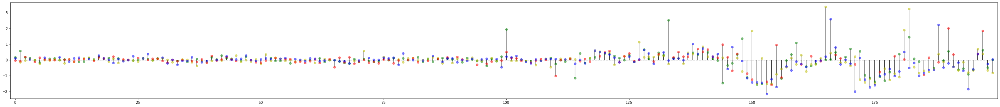

In-silico mutagenesis | pred_lfc: 1.7146 |


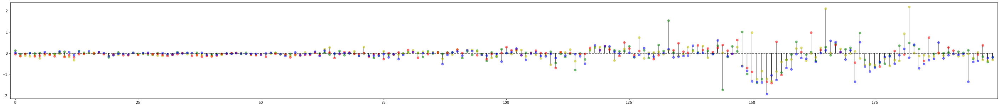

Variant contribution scores


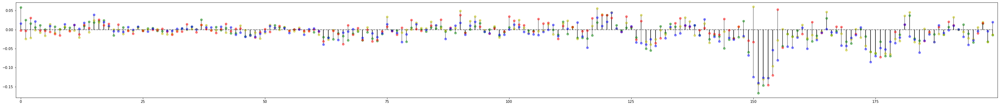



--------------- chr19:30843409-30843609 ---------------

In-vitro mutagenesis | ref_lfc: 0.2133, ref_lfcSE: 0.1441 |


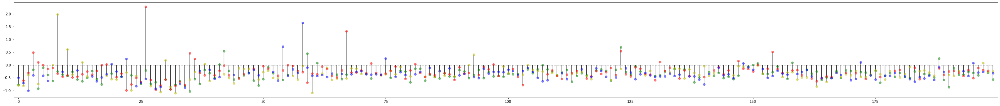

In-silico mutagenesis | pred_lfc: -0.2243 |


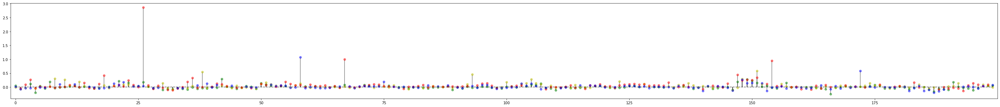

Variant contribution scores


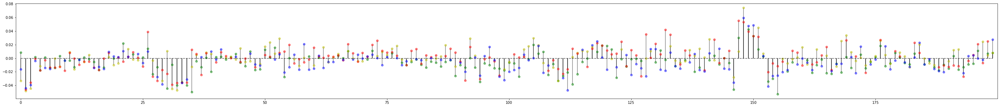



--------------- chr1:47041104-47041304 ---------------

In-vitro mutagenesis | ref_lfc: 0.3866, ref_lfcSE: 0.2172 |


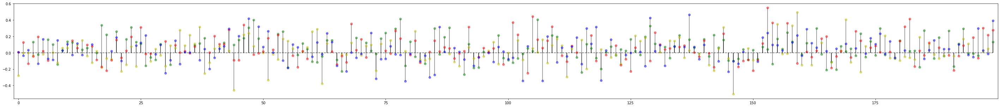

In-silico mutagenesis | pred_lfc: 1.031 |


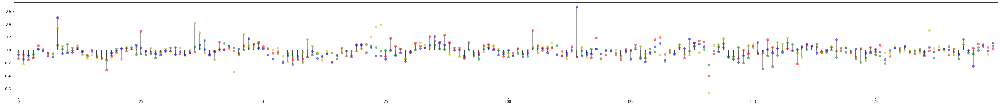

Variant contribution scores


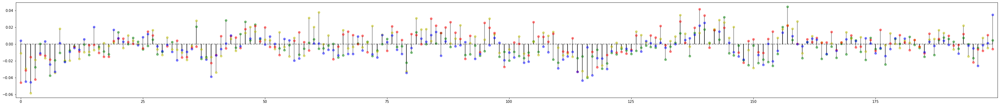



--------------- chr1:90847872-90848072 ---------------

In-vitro mutagenesis | ref_lfc: -0.0841, ref_lfcSE: 0.0918 |


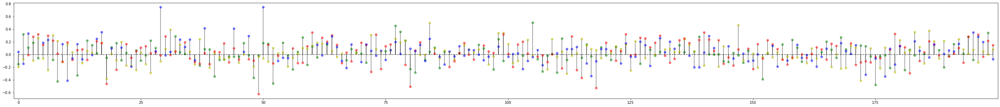

In-silico mutagenesis | pred_lfc: -0.1275 |


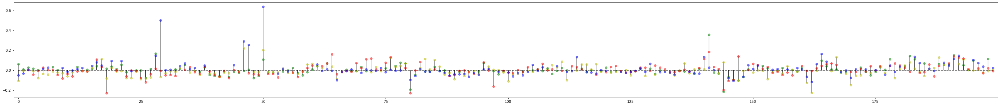

Variant contribution scores


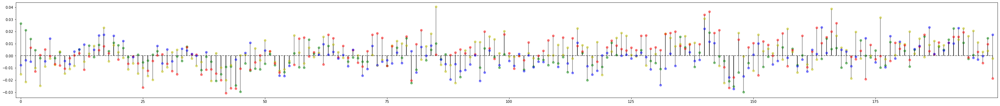



--------------- chr2:60077721-60077921 ---------------

In-vitro mutagenesis | ref_lfc: -0.5163, ref_lfcSE: 0.068 |


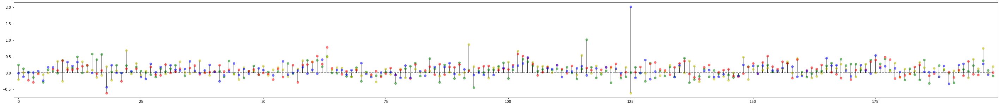

In-silico mutagenesis | pred_lfc: -0.3823 |


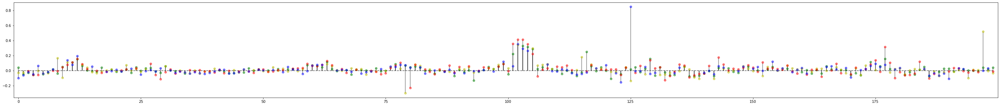

Variant contribution scores


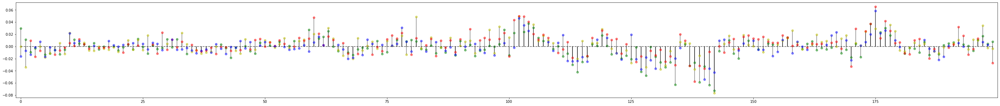



--------------- chr3:136760181-136760381 ---------------

In-vitro mutagenesis | ref_lfc: 0.195, ref_lfcSE: 0.1069 |


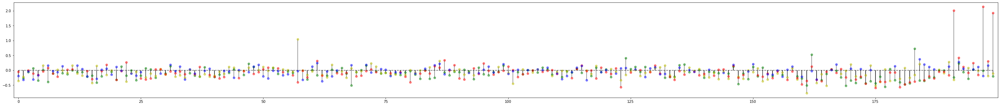

In-silico mutagenesis | pred_lfc: 0.3062 |


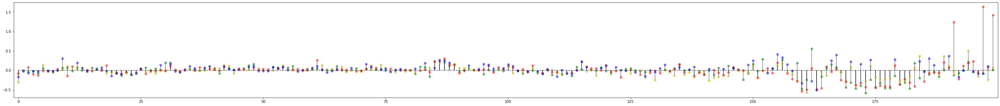

Variant contribution scores


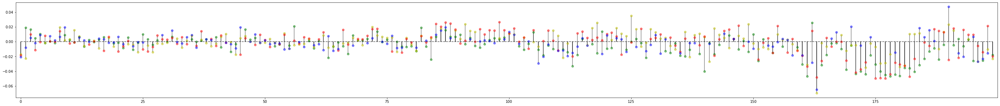



--------------- chr3:19028436-19028636 ---------------

In-vitro mutagenesis | ref_lfc: 0.4588, ref_lfcSE: 0.1109 |


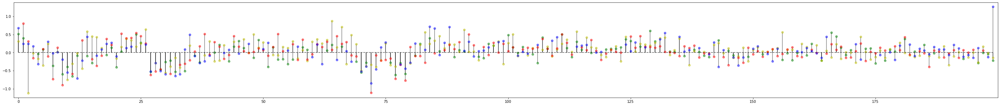

In-silico mutagenesis | pred_lfc: 0.6211 |


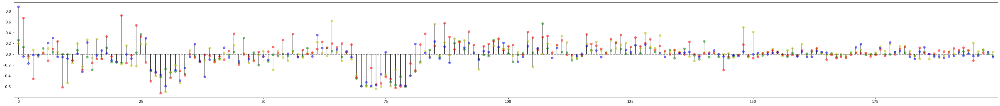

Variant contribution scores


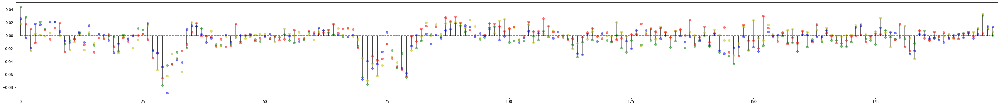



--------------- chr4:147215670-147215870 ---------------

In-vitro mutagenesis | ref_lfc: -0.6131, ref_lfcSE: 1.2738 |


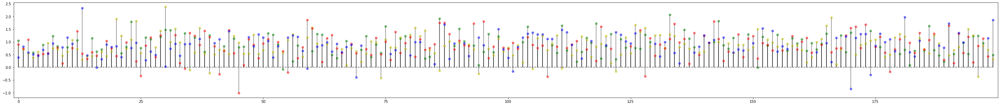

In-silico mutagenesis | pred_lfc: 0.7439 |


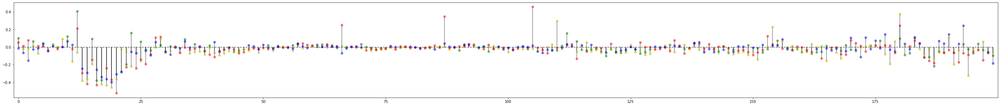

Variant contribution scores


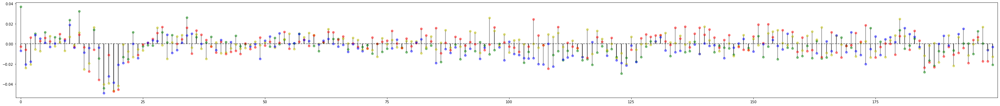



--------------- chr5:87852766-87852966 ---------------

In-vitro mutagenesis | ref_lfc: 0.3435, ref_lfcSE: 0.1754 |


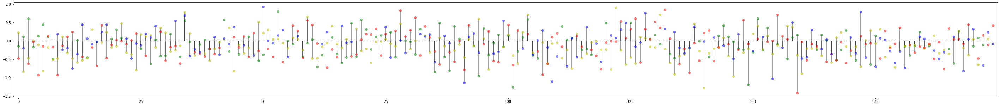

In-silico mutagenesis | pred_lfc: 0.5612 |


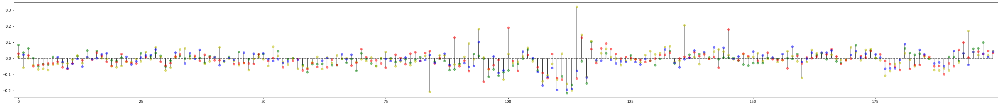

Variant contribution scores


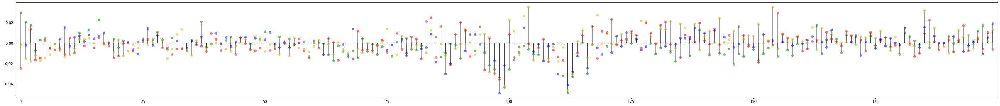



--------------- chr6:136595273-136595473 ---------------

In-vitro mutagenesis | ref_lfc: 1.0814, ref_lfcSE: 0.9527 |


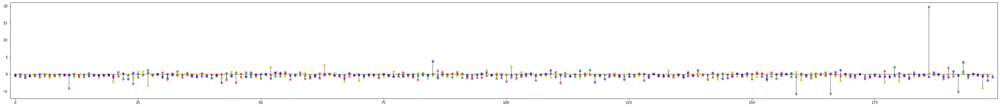

In-silico mutagenesis | pred_lfc: 1.0296 |


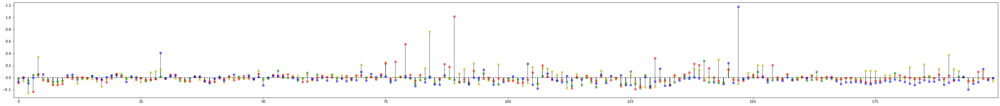

Variant contribution scores


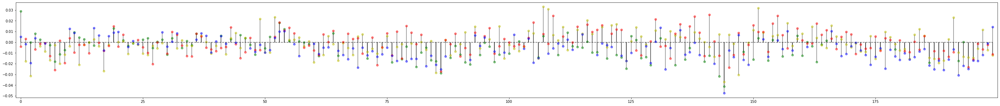



--------------- chr6:14501550-14501750 ---------------

In-vitro mutagenesis | ref_lfc: 1.6493, ref_lfcSE: 0.0976 |


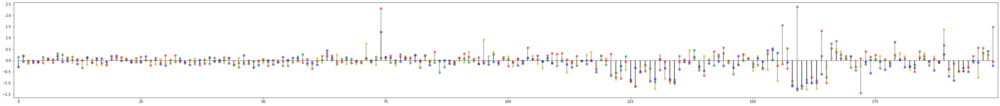

In-silico mutagenesis | pred_lfc: 1.1204 |


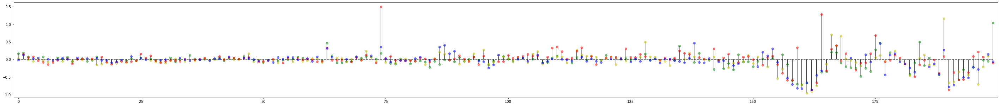

Variant contribution scores


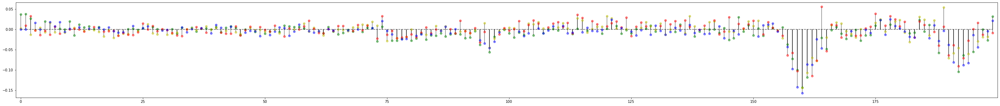



--------------- chr6:91342117-91342317 ---------------

In-vitro mutagenesis | ref_lfc: 0.7317, ref_lfcSE: 0.0809 |


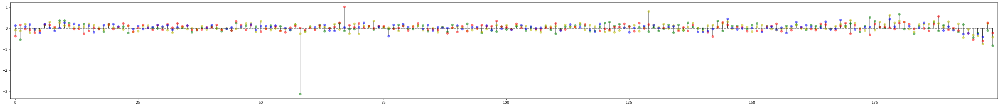

In-silico mutagenesis | pred_lfc: 0.6972 |


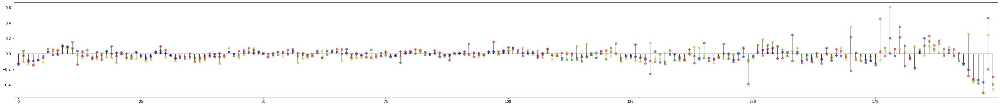

Variant contribution scores


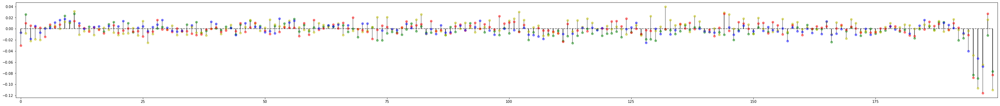



--------------- chr7:100480515-100480715 ---------------

In-vitro mutagenesis | ref_lfc: 0.8965, ref_lfcSE: 0.0773 |


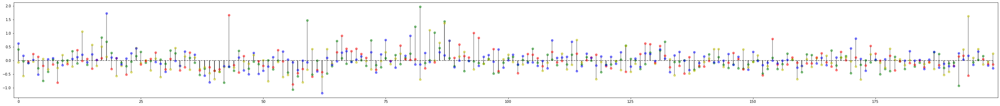

In-silico mutagenesis | pred_lfc: 1.2008 |


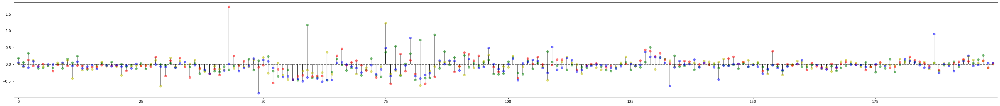

Variant contribution scores


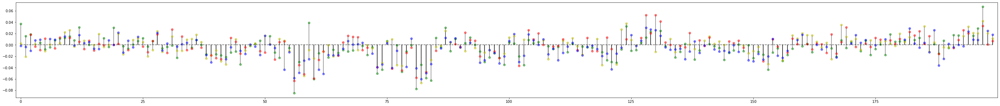



--------------- chr7:114999468-114999668 ---------------

In-vitro mutagenesis | ref_lfc: -0.0764, ref_lfcSE: 0.098 |


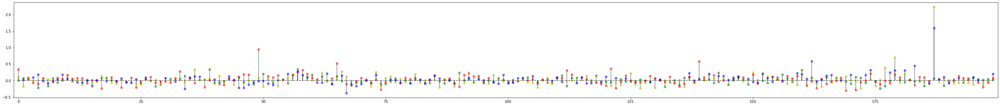

In-silico mutagenesis | pred_lfc: 0.3768 |


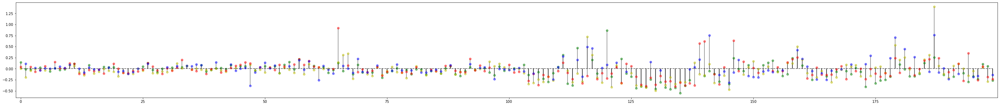

Variant contribution scores


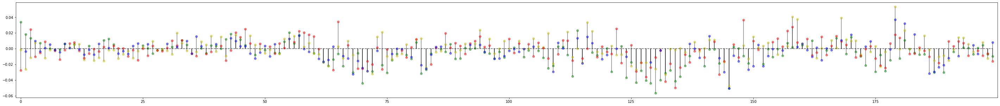



--------------- chr7:114999561-114999761 ---------------

In-vitro mutagenesis | ref_lfc: 1.362, ref_lfcSE: 0.0919 |


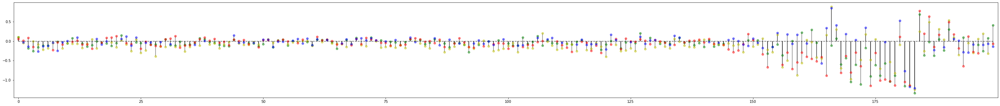

In-silico mutagenesis | pred_lfc: 0.2697 |


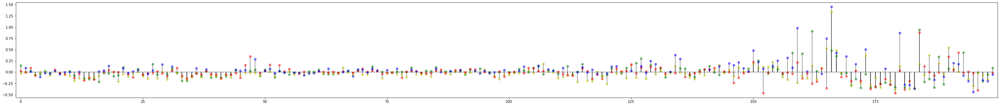

Variant contribution scores


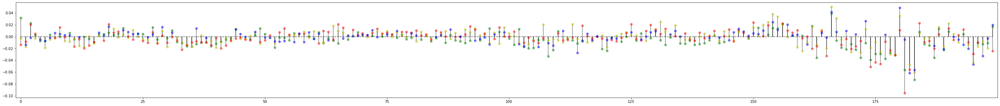

In [324]:
idx_count = 0
for key in effect_tensor_dict.keys():
    decor_print(key)
    ref_lfc = effect_tensor_dict[key]['ref_lfc']
    ref_lfcSE = effect_tensor_dict[key]['ref_lfcSE']
    num_variants = effect_tensor_dict[key]['num_mpra_alts']
    print(f'In-vitro mutagenesis | ref_lfc: {round(ref_lfc, 4)}, ref_lfcSE: {round(ref_lfcSE, 4)} |')#' | num of variants: {num_variants}/600')
    matrix = effect_tensor_dict[key]['mpra_effect'].view(4,-1)
    _ = plot_variant_effects(matrix.numpy())
    plt.show()
    
    ref_tensor = batch_tensor[idx_count,...]
    ref_prediction = float(ref_predictions[idx_count,...])
    
    
    print(f'In-silico mutagenesis | pred_lfc: {round(ref_prediction, 4)} |')
    matrix = predicted_saturations[idx_count].view(4,-1)
    _ = plot_variant_effects(matrix.numpy())
    plt.show()
        
    print(f'Variant contribution scores')
    effect_tensor = (torch.ones_like(ref_tensor) - ref_tensor) * extended_contributions[idx_count,...]
    matrix = effect_tensor.view(4,-1)
    _ = plot_variant_effects(matrix.numpy())
    plt.show()
    
    idx_count += 1
    print('')


--------------- chr14:29859932-29860132 ---------------

In-vitro mean effects | ref_lfc: 0.7349, ref_lfcSE: 0.0918 | Effect sum: -4.4527 |


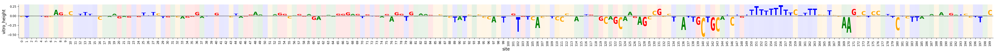

In-silico mean effects | ref_pred_lfc: 1.0003 | Effect sum: 0.2729 |


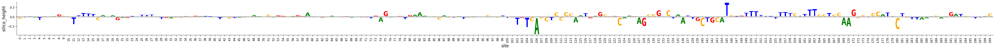

Contribution scores | ref_pred_lfc: 1.0003 | Contribution sum: 2.7423 |


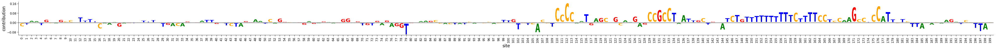


--------------- chr14:37559109-37559309 ---------------

In-vitro mean effects | ref_lfc: -0.2037, ref_lfcSE: 0.0615 | Effect sum: -10.9396 |


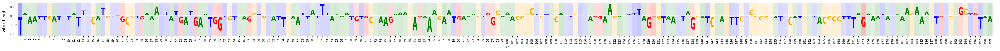

In-silico mean effects | ref_pred_lfc: -0.1531 | Effect sum: -1.8817 |


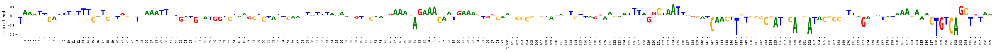

Contribution scores | ref_pred_lfc: -0.1531 | Contribution sum: -0.164 |


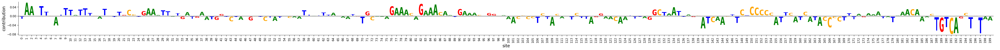


--------------- chr14:57553315-57553515 ---------------

In-vitro mean effects | ref_lfc: 0.8462, ref_lfcSE: 0.1354 | Effect sum: -5.3307 |


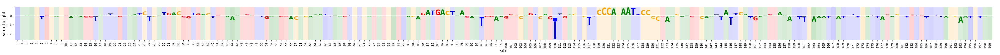

In-silico mean effects | ref_pred_lfc: 1.5192 | Effect sum: 18.2427 |


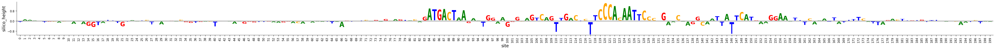

Contribution scores | ref_pred_lfc: 1.5192 | Contribution sum: 5.4993 |


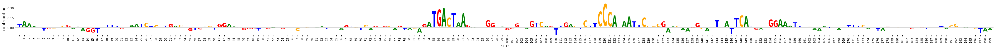


--------------- chr17:2095085-2095285 ---------------

In-vitro mean effects | ref_lfc: 1.2781, ref_lfcSE: 0.0712 | Effect sum: -1.4162 |


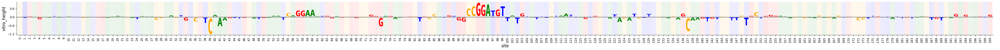

In-silico mean effects | ref_pred_lfc: 0.894 | Effect sum: -5.7463 |


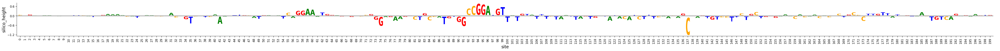

Contribution scores | ref_pred_lfc: 0.894 | Contribution sum: 3.5402 |


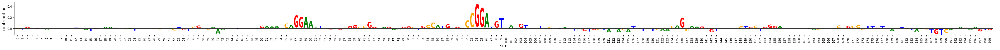


--------------- chr17:2095258-2095458 ---------------

In-vitro mean effects | ref_lfc: 1.9521, ref_lfcSE: 0.0806 | Effect sum: 7.7235 |


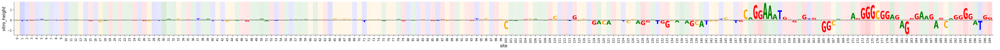

In-silico mean effects | ref_pred_lfc: 1.7146 | Effect sum: 11.264 |


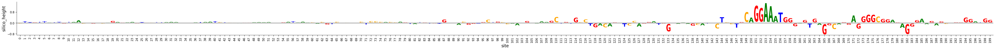

Contribution scores | ref_pred_lfc: 1.7146 | Contribution sum: 4.2598 |


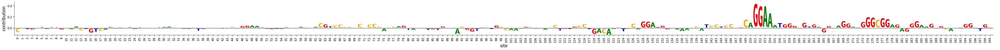


--------------- chr19:30843409-30843609 ---------------

In-vitro mean effects | ref_lfc: 0.2133, ref_lfcSE: 0.1441 | Effect sum: 66.2075 |


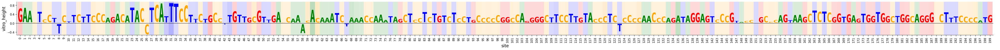

In-silico mean effects | ref_pred_lfc: -0.2243 | Effect sum: -7.8071 |


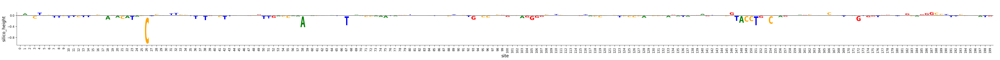

Contribution scores | ref_pred_lfc: -0.2243 | Contribution sum: 1.582 |


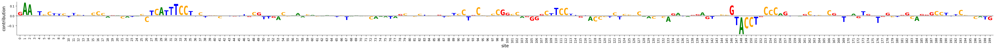


--------------- chr1:47041104-47041304 ---------------

In-vitro mean effects | ref_lfc: 0.3866, ref_lfcSE: 0.2172 | Effect sum: -7.5875 |


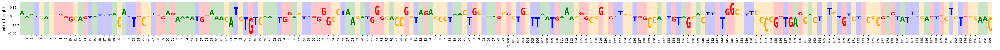

In-silico mean effects | ref_pred_lfc: 1.031 | Effect sum: 2.5365 |


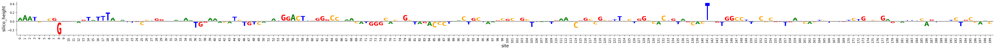

Contribution scores | ref_pred_lfc: 1.031 | Contribution sum: 1.2149 |


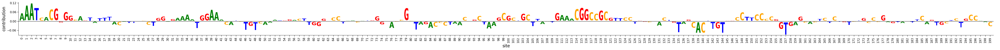


--------------- chr1:90847872-90848072 ---------------

In-vitro mean effects | ref_lfc: -0.0841, ref_lfcSE: 0.0918 | Effect sum: -6.1788 |


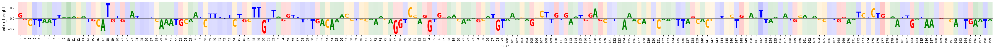

In-silico mean effects | ref_pred_lfc: -0.1275 | Effect sum: -1.3566 |


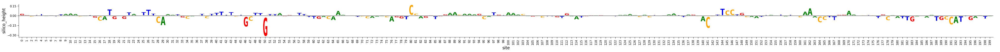

Contribution scores | ref_pred_lfc: -0.1275 | Contribution sum: -0.5572 |


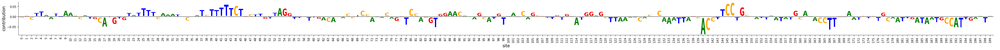


--------------- chr2:60077721-60077921 ---------------

In-vitro mean effects | ref_lfc: -0.5163, ref_lfcSE: 0.068 | Effect sum: -18.7909 |


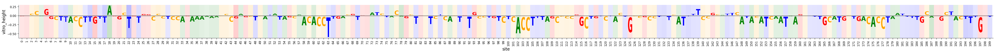

In-silico mean effects | ref_pred_lfc: -0.3823 | Effect sum: -4.1351 |


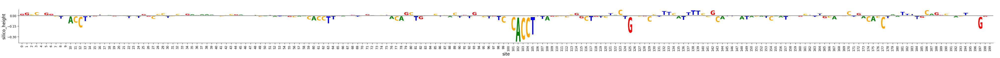

Contribution scores | ref_pred_lfc: -0.3823 | Contribution sum: -0.3167 |


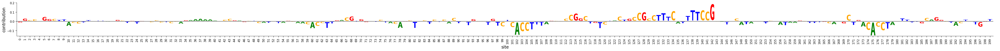


--------------- chr3:136760181-136760381 ---------------

In-vitro mean effects | ref_lfc: 0.195, ref_lfcSE: 0.1069 | Effect sum: 13.67 |


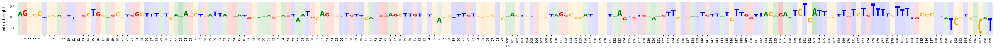

In-silico mean effects | ref_pred_lfc: 0.3062 | Effect sum: 0.4564 |


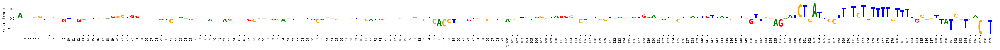

Contribution scores | ref_pred_lfc: 0.3062 | Contribution sum: 1.6217 |


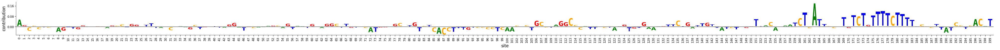


--------------- chr3:19028436-19028636 ---------------

In-vitro mean effects | ref_lfc: 0.4588, ref_lfcSE: 0.1109 | Effect sum: -6.6041 |


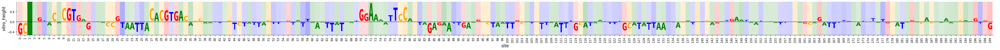

In-silico mean effects | ref_pred_lfc: 0.6211 | Effect sum: 0.3771 |


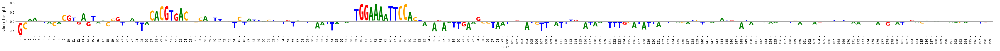

Contribution scores | ref_pred_lfc: 0.6211 | Contribution sum: 2.2923 |


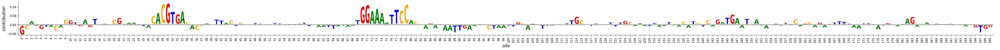


--------------- chr4:147215670-147215870 ---------------

In-vitro mean effects | ref_lfc: -0.6131, ref_lfcSE: 1.2738 | Effect sum: -171.5346 |


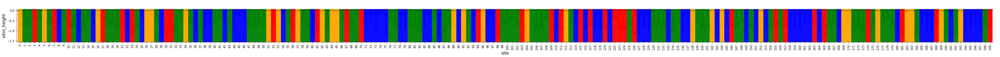

In-silico mean effects | ref_pred_lfc: 0.7439 | Effect sum: 4.8039 |


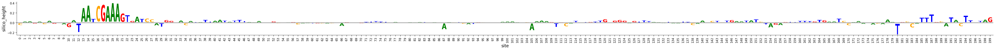

Contribution scores | ref_pred_lfc: 0.7439 | Contribution sum: 1.173 |


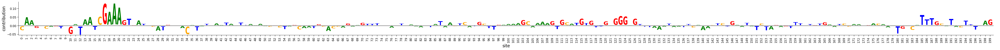


--------------- chr5:87852766-87852966 ---------------

In-vitro mean effects | ref_lfc: 0.3435, ref_lfcSE: 0.1754 | Effect sum: 21.1545 |


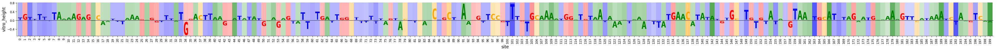

In-silico mean effects | ref_pred_lfc: 0.5612 | Effect sum: 1.219 |


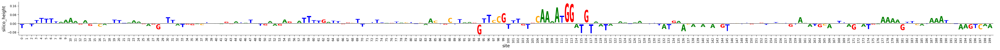

Contribution scores | ref_pred_lfc: 0.5612 | Contribution sum: 0.5278 |


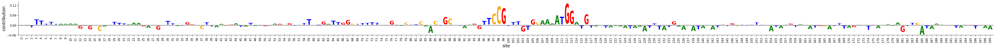


--------------- chr6:136595273-136595473 ---------------

In-vitro mean effects | ref_lfc: 1.0814, ref_lfcSE: 0.9527 | Effect sum: 69.0419 |


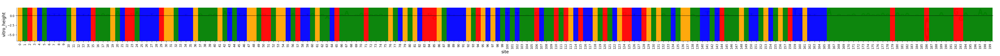

In-silico mean effects | ref_pred_lfc: 1.0296 | Effect sum: 0.7978 |


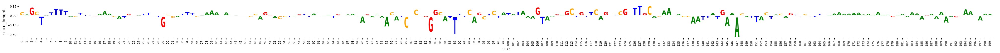

Contribution scores | ref_pred_lfc: 1.0296 | Contribution sum: 1.8788 |


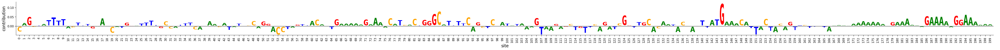


--------------- chr6:14501550-14501750 ---------------

In-vitro mean effects | ref_lfc: 1.6493, ref_lfcSE: 0.0976 | Effect sum: 13.4999 |


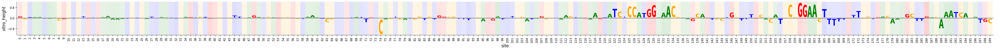

In-silico mean effects | ref_pred_lfc: 1.1204 | Effect sum: 4.3741 |


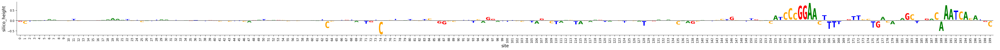

Contribution scores | ref_pred_lfc: 1.1204 | Contribution sum: 3.617 |


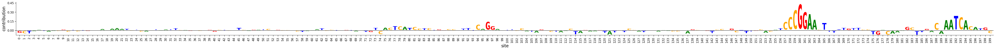


--------------- chr6:91342117-91342317 ---------------

In-vitro mean effects | ref_lfc: 0.7317, ref_lfcSE: 0.0809 | Effect sum: -6.6986 |


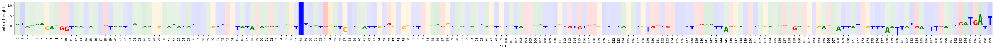

In-silico mean effects | ref_pred_lfc: 0.6972 | Effect sum: 2.1902 |


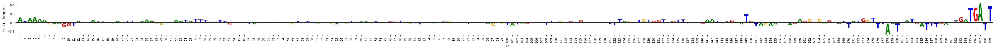

Contribution scores | ref_pred_lfc: 0.6972 | Contribution sum: 0.812 |


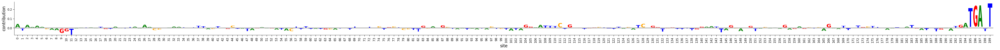


--------------- chr7:100480515-100480715 ---------------

In-vitro mean effects | ref_lfc: 0.8965, ref_lfcSE: 0.0773 | Effect sum: 0.765 |


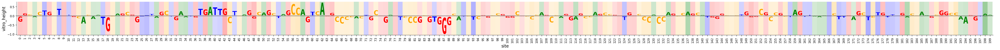

In-silico mean effects | ref_pred_lfc: 1.2008 | Effect sum: 6.3857 |


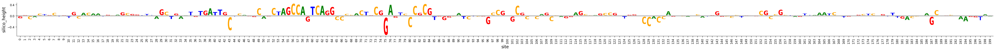

Contribution scores | ref_pred_lfc: 1.2008 | Contribution sum: 2.1204 |


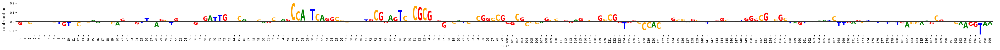


--------------- chr7:114999468-114999668 ---------------

In-vitro mean effects | ref_lfc: -0.0764, ref_lfcSE: 0.098 | Effect sum: -5.6746 |


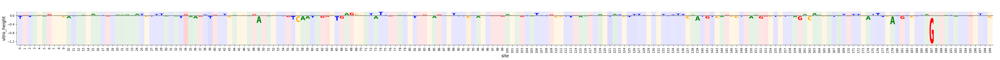

In-silico mean effects | ref_pred_lfc: 0.3768 | Effect sum: 5.6901 |


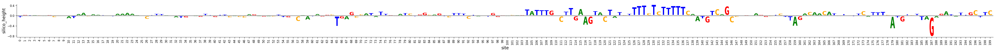

Contribution scores | ref_pred_lfc: 0.3768 | Contribution sum: 1.8528 |


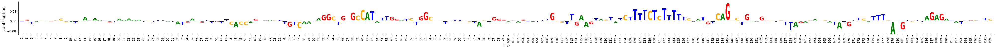


--------------- chr7:114999561-114999761 ---------------

In-vitro mean effects | ref_lfc: 1.362, ref_lfcSE: 0.0919 | Effect sum: 20.9925 |


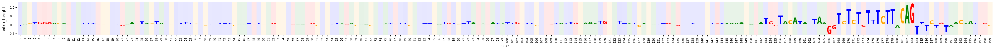

In-silico mean effects | ref_pred_lfc: 0.2697 | Effect sum: -0.815 |


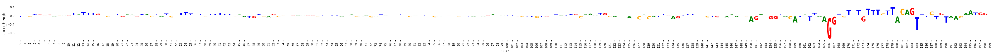

Contribution scores | ref_pred_lfc: 0.2697 | Contribution sum: 1.3903 |


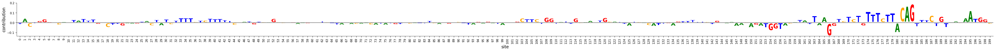

In [328]:
colors=['green','orange','red','blue']

idx_count = 0
for key in effect_tensor_dict.keys():
    decor_print(key)
    tensor_dict = effect_tensor_dict[key]

    ref_sequence = tensor_dict['ref_sequence']
    
    #mpra
    effect_array = tensor_dict['mpra_effect'].numpy()
    effect_means = - effect_array.sum(axis=0) / 3.0
    lfcSE_means = tensor_dict['lfcSE_tensor'].numpy().sum(axis=0) / 3.0   
    
    ref_lfcSE = tensor_dict['ref_lfcSE']
    alphas = np.minimum(np.maximum(lfcSE_means, ref_lfcSE), 0.95)

    temp_data = [list(ref_sequence), effect_means, alphas]
    temp_df = pd.DataFrame(temp_data).transpose()
    temp_df.columns = ['letter', 'vitro_height', 'shade']
    temp_df['color'] = temp_df.apply(lambda x: colors[constants.STANDARD_NT.index(x['letter'])], axis=1)
    temp_df['site'] = temp_df.index
    
    ref_lfc = tensor_dict['ref_lfc']
    effect_total = float(effect_means.sum())
    print(f'In-vitro mean effects | ref_lfc: {round(ref_lfc, 4)}, ref_lfcSE: {round(ref_lfcSE, 4)} | Effect sum: {round(effect_total, 4)} |')
    fig, ax = dmslogo.draw_logo(data=temp_df,
                                x_col='site',
                                letter_col='letter',
                                letter_height_col='vitro_height',
                                color_col='color',
                                shade_color_col='color',
                                shade_alpha_col='shade')
    plt.show()
    
    #model
    silico_mean_effects = - predicted_saturations[idx_count].sum(dim=0) / 3.0
    temp_df['silico_height'] = silico_mean_effects.numpy()
    
    ref_prediction = float(ref_predictions[idx_count,...])
    silico_effect_total = float(silico_mean_effects.sum())
    print(f'In-silico mean effects | ref_pred_lfc: {round(ref_prediction, 4)} | Effect sum: {round(silico_effect_total, 4)} |')
    fig, ax = dmslogo.draw_logo(data=temp_df,
                                x_col='site',
                                letter_col='letter',
                                letter_height_col='silico_height',
                                color_col='color')
    plt.show()
    
    #isg
    contributions = salient_maps[idx_count,...].detach().sum(dim=0).numpy()
    temp_df['contribution'] = contributions
    contribution_sum = float(contributions.sum())
    
    print(f'Contribution scores | ref_pred_lfc: {round(ref_prediction, 4)} | Contribution sum: {round(contribution_sum, 4)} |')
    fig, ax = dmslogo.draw_logo(data=temp_df,
                                x_col='site',
                                letter_col='letter',
                                letter_height_col='contribution',
                                color_col='color')
    plt.show()
    
    idx_count += 1

In [153]:
def plot_satmut(ref_sequence_str, effect_array, lfcSE_array=None, ref_lfcSE=None, colors=['g', 'C1', 'r', 'b'], figsize=(50,5),
                         marker_alpha=1., stem_alpha=0.5, linestyle='dashed', ax=None):
    markerfmts = [color + 'o' for color in colors]
    locs = np.arange(0, effect_array.shape[1])
    fig, ax = plt.subplots(figsize=(50,5))
    
    offset = 0.5
    for i in range(4):
        heads = np.array(effect_array[i,:], copy=True)
        heads[heads == 0.] = np.nan
        markerline, stemlines, baseline = ax.stem(locs + offset, heads, colors[i], markerfmt=markerfmts[i], basefmt='0.8')
        plt.setp(stemlines, 'linestyle', linestyle)
        plt.setp(stemlines, 'alpha', stem_alpha)
        plt.setp(markerline, 'alpha', marker_alpha)
        #plt.setp(baseline, 'color', 'k')
        plt.setp(baseline, 'alpha', 0.2)
        plt.setp(baseline, 'linestyle', 'dashed')
        
        #offset += 0.1
    plt.margins(x=0.0075)
    
    effect_means = - effect_array.sum(axis=0) / 3.0
        
    if lfcSE_array is not None and ref_lfcSE is not None:
        lfcSE_means = lfcSE_array.sum(axis=0) / 3.0  
        alphas = np.minimum(np.maximum(lfcSE_means, ref_lfcSE), 0.90)
        shade_color_col='color'
        shade_alpha_col='shade'
    else:
        alphas = np.empty(effect_means.shape[0])
        alphas[:] = np.nan
        shade_color_col=None
        shade_alpha_col=None
    
    temp_data = [list(ref_sequence_str), effect_means, alphas]
    temp_df = pd.DataFrame(temp_data).transpose()
    temp_df.columns = ['letter', 'height', 'shade']
    
    temp_df['color'] = temp_df.apply(lambda x: colors[constants.STANDARD_NT.index(x['letter'])], axis=1)
    temp_df['site'] = temp_df.index
    
    y_max = max(effect_array.max(), effect_means.max()) + 0.1
    y_min = min(effect_array.min(), effect_means.min()) - 0.1
    
    fig, ax = dmslogo.draw_logo(data=temp_df,
                            x_col='site',
                            letter_col='letter',
                            letter_height_col='height',
                            color_col='color',
                            shade_color_col=shade_color_col,
                            shade_alpha_col=shade_alpha_col,
                            hide_axis=True,
                            fixed_ymax=y_max,
                            fixed_ymin=y_min,
                            ax=ax)
    plt.show()
    
def plot_complete_contributions(ref_sequence_str, contributions_array, colors=['g', 'C1', 'r', 'b'], figsize=(50,5),
                         marker_alpha=1., stem_alpha=0.5, linestyle='dashed', ax=None):
    ref_array = utils.dna2tensor(ref_sequence_str).numpy()
    effect_array = (np.ones_like(ref_array) - ref_array) * contributions_array
      
    markerfmts = [color + 'o' for color in colors]
    locs = np.arange(0, effect_array.shape[1])
    fig, ax = plt.subplots(figsize=(50,5))
    
    offset = 0.5
    for i in range(4):
        heads = np.array(effect_array[i,:], copy=True)
        heads[heads == 0.] = np.nan
        markerline, stemlines, baseline = ax.stem(locs + offset, heads, colors[i], markerfmt=markerfmts[i], basefmt='0.8')
        plt.setp(stemlines, 'linestyle', linestyle)
        plt.setp(stemlines, 'alpha', stem_alpha)
        plt.setp(markerline, 'alpha', marker_alpha)
        #plt.setp(baseline, 'color', 'k')
        plt.setp(baseline, 'alpha', 0.2)
        plt.setp(baseline, 'linestyle', 'dashed')
        
        #offset += 0.1
    plt.margins(x=0.0075)
    
    effect_means = - effect_array.sum(axis=0) / 3.0
    
    temp_data = [list(ref_sequence_str), effect_means]
    temp_df = pd.DataFrame(temp_data).transpose()
    temp_df.columns = ['letter', 'height']
    
    temp_df['color'] = temp_df.apply(lambda x: colors[constants.STANDARD_NT.index(x['letter'])], axis=1)
    temp_df['site'] = temp_df.index
    
    y_max = max(effect_array.max(), effect_means.max()) + 0.1
    y_min = min(effect_array.min(), effect_means.min()) - 0.1
    
    fig, ax = dmslogo.draw_logo(data=temp_df,
                            x_col='site',
                            letter_col='letter',
                            letter_height_col='height',
                            color_col='color',
                            hide_axis=True,
                            fixed_ymax=y_max,
                            fixed_ymin=y_min,
                            ax=ax)
    plt.show()


--------------- chr14:29859932-29860132 ---------------

In-vitro | ref_lfc: 0.7349, ref_lfcSE: 0.0918 | Effect sum: -4.4527 |


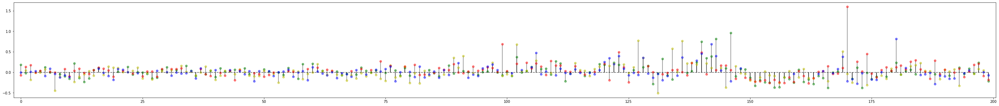

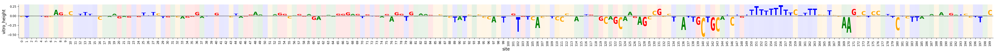

In-silico | ref_pred_lfc: 1.0003 | Effect sum: 0.2729 |


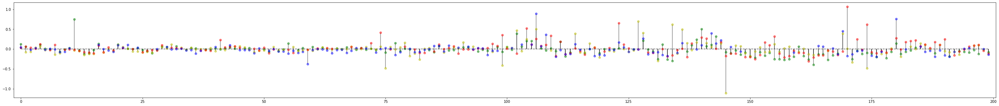

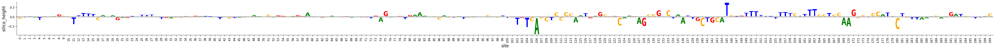

Contribution scores | ref_pred_lfc: 1.0003 | Contribution sum: 2.4535 |


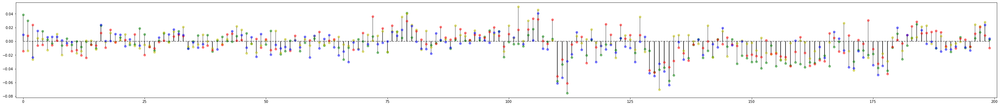

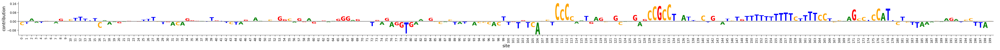



--------------- chr14:37559109-37559309 ---------------

In-vitro | ref_lfc: -0.2037, ref_lfcSE: 0.0615 | Effect sum: -10.9396 |


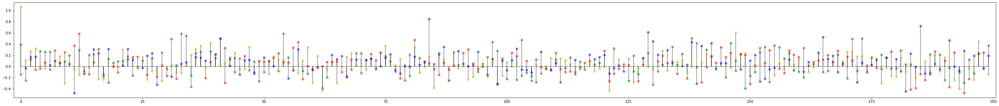

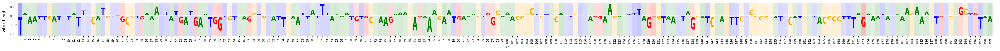

In-silico | ref_pred_lfc: -0.1531 | Effect sum: -1.8817 |


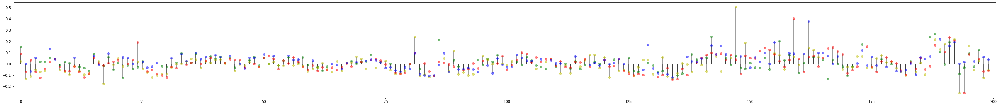

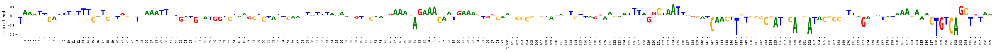

Contribution scores | ref_pred_lfc: -0.1531 | Contribution sum: -0.0202 |


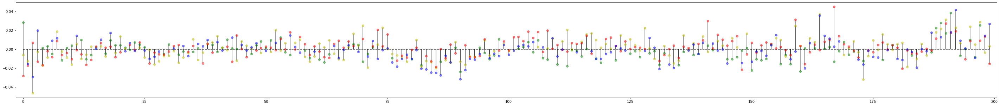

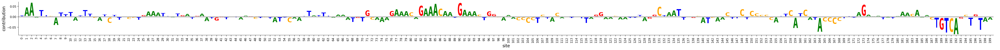



--------------- chr14:57553315-57553515 ---------------

In-vitro | ref_lfc: 0.8462, ref_lfcSE: 0.1354 | Effect sum: -5.3307 |


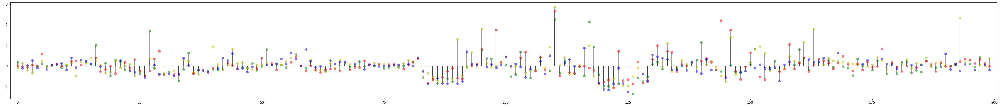

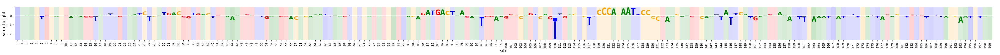

In-silico | ref_pred_lfc: 1.5192 | Effect sum: 18.2427 |


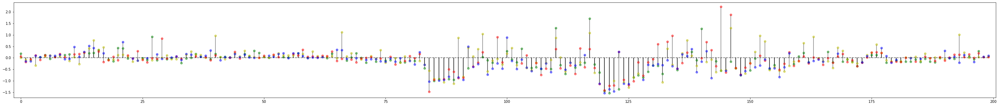

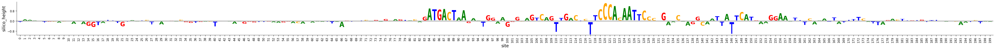

Contribution scores | ref_pred_lfc: 1.5192 | Contribution sum: 5.2711 |


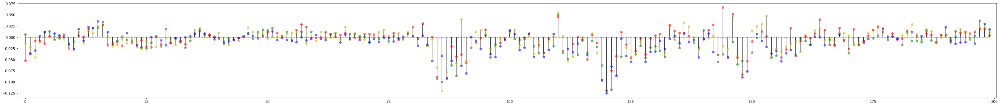

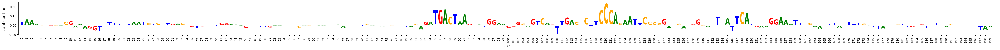



--------------- chr17:2095085-2095285 ---------------

In-vitro | ref_lfc: 1.2781, ref_lfcSE: 0.0712 | Effect sum: -1.4162 |


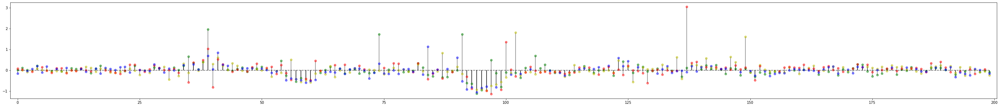

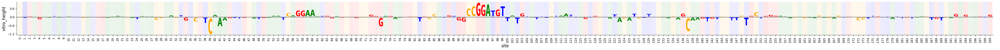

In-silico | ref_pred_lfc: 0.894 | Effect sum: -5.7463 |


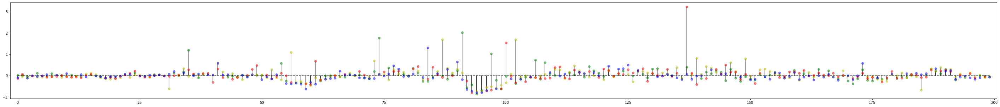

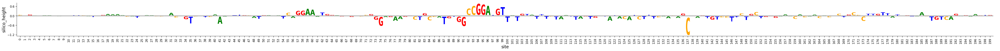

Contribution scores | ref_pred_lfc: 0.894 | Contribution sum: 3.1723 |


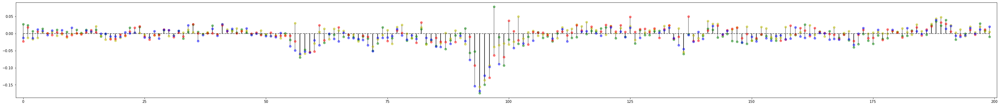

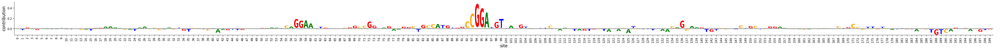



--------------- chr17:2095258-2095458 ---------------

In-vitro | ref_lfc: 1.9521, ref_lfcSE: 0.0806 | Effect sum: 7.7235 |


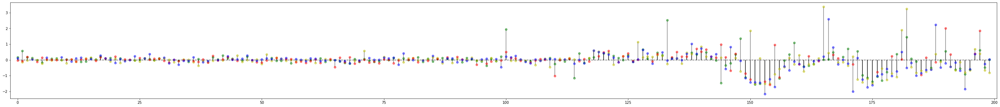

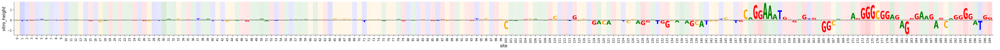

In-silico | ref_pred_lfc: 1.7146 | Effect sum: 11.264 |


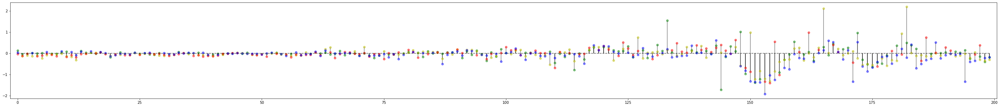

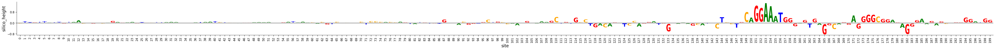

Contribution scores | ref_pred_lfc: 1.7146 | Contribution sum: 4.2358 |


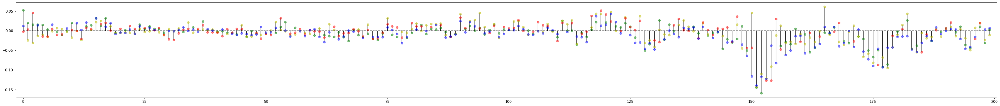

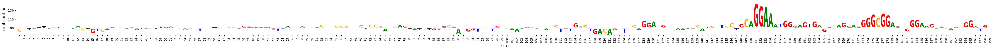



--------------- chr19:30843409-30843609 ---------------

In-vitro | ref_lfc: 0.2133, ref_lfcSE: 0.1441 | Effect sum: 66.2075 |


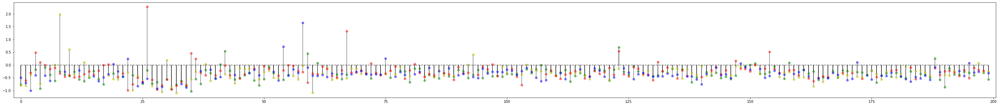

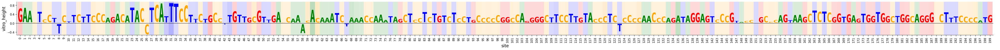

In-silico | ref_pred_lfc: -0.2243 | Effect sum: -7.8071 |


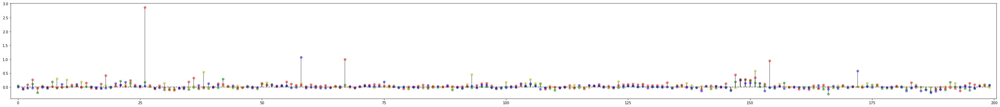

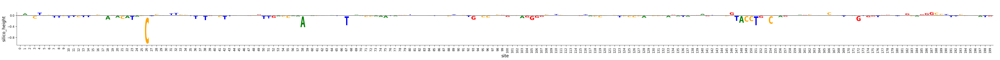

Contribution scores | ref_pred_lfc: -0.2243 | Contribution sum: 1.75 |


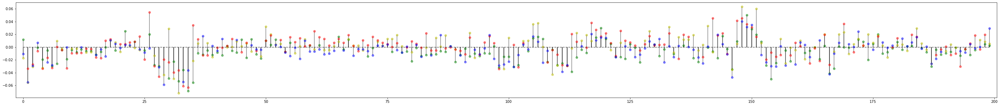

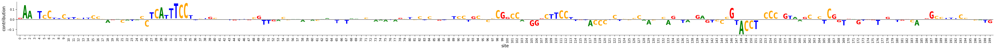



--------------- chr1:47041104-47041304 ---------------

In-vitro | ref_lfc: 0.3866, ref_lfcSE: 0.2172 | Effect sum: -7.5875 |


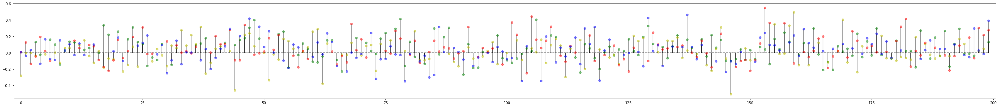

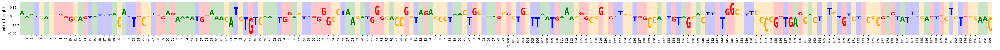

In-silico | ref_pred_lfc: 1.031 | Effect sum: 2.5365 |


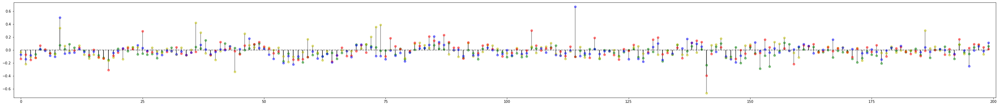

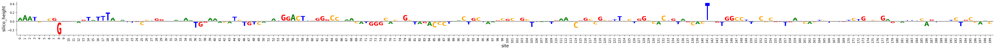

Contribution scores | ref_pred_lfc: 1.031 | Contribution sum: 1.1781 |


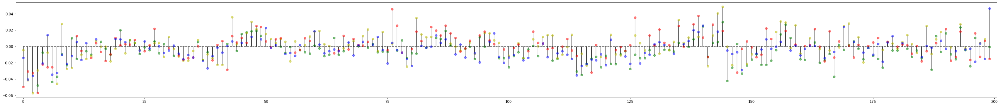

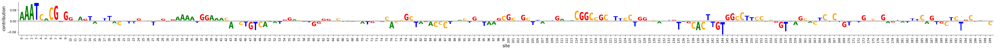



--------------- chr1:90847872-90848072 ---------------

In-vitro | ref_lfc: -0.0841, ref_lfcSE: 0.0918 | Effect sum: -6.1788 |


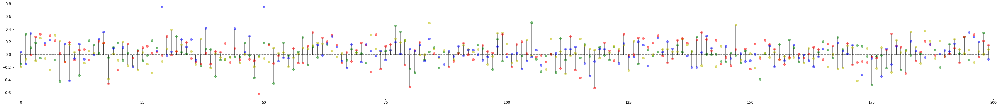

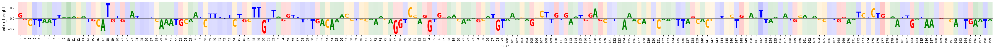

In-silico | ref_pred_lfc: -0.1275 | Effect sum: -1.3566 |


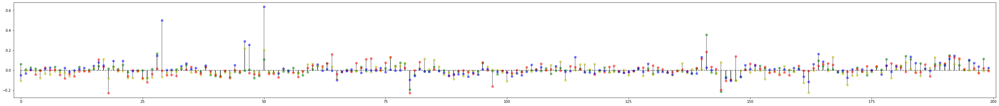

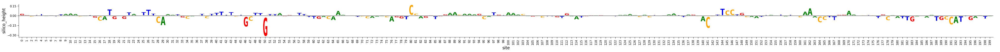

Contribution scores | ref_pred_lfc: -0.1275 | Contribution sum: -0.1992 |


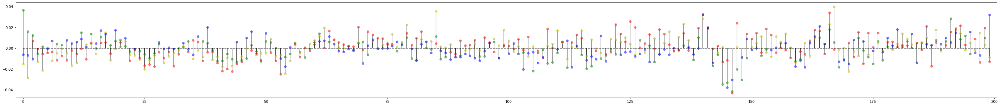

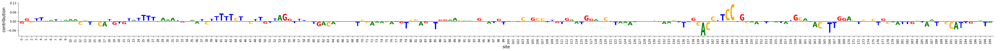



--------------- chr2:60077721-60077921 ---------------

In-vitro | ref_lfc: -0.5163, ref_lfcSE: 0.068 | Effect sum: -18.7909 |


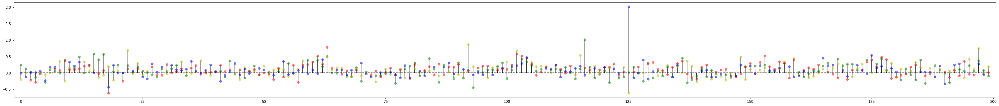

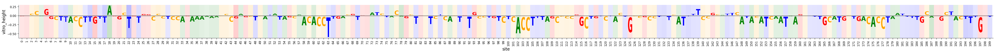

In-silico | ref_pred_lfc: -0.3823 | Effect sum: -4.1351 |


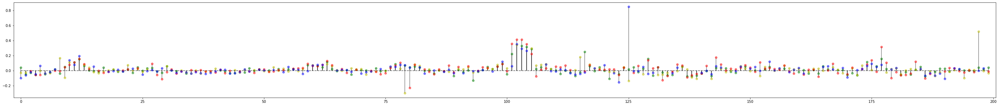

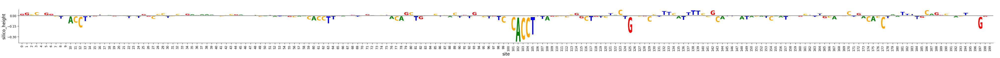

Contribution scores | ref_pred_lfc: -0.3823 | Contribution sum: 0.223 |


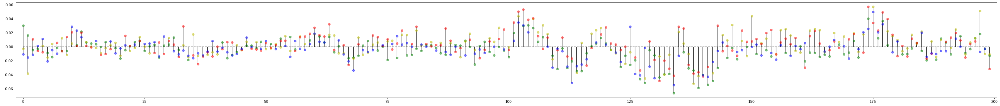

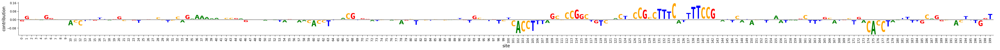



--------------- chr3:136760181-136760381 ---------------

In-vitro | ref_lfc: 0.195, ref_lfcSE: 0.1069 | Effect sum: 13.67 |


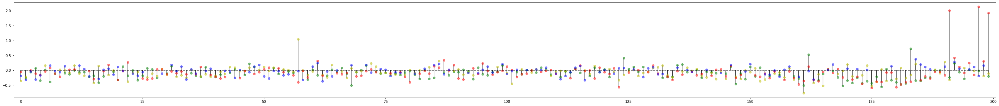

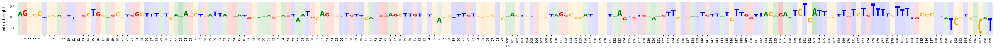

In-silico | ref_pred_lfc: 0.3062 | Effect sum: 0.4564 |


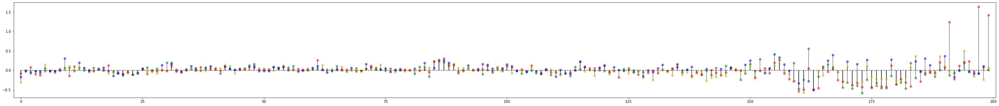

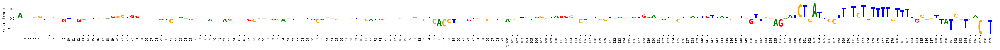

Contribution scores | ref_pred_lfc: 0.3062 | Contribution sum: 1.4316 |


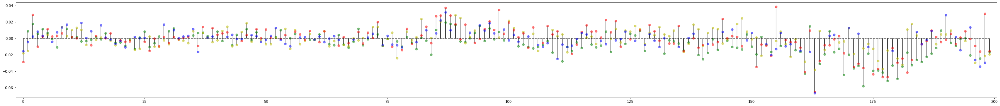

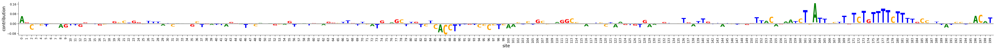



--------------- chr3:19028436-19028636 ---------------

In-vitro | ref_lfc: 0.4588, ref_lfcSE: 0.1109 | Effect sum: -6.6041 |


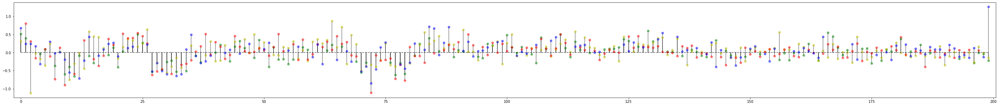

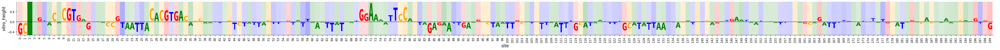

In-silico | ref_pred_lfc: 0.6211 | Effect sum: 0.3771 |


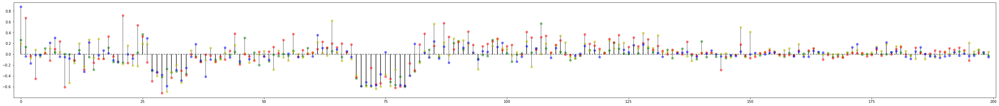

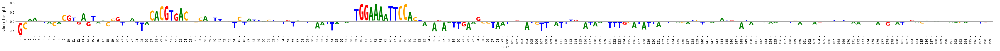

Contribution scores | ref_pred_lfc: 0.6211 | Contribution sum: 2.7446 |


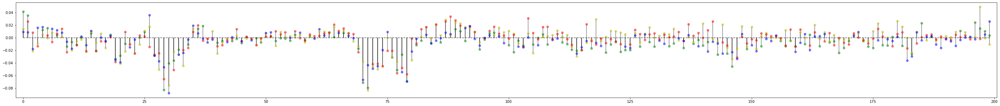

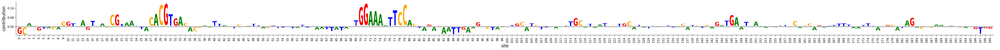



--------------- chr4:147215670-147215870 ---------------

In-vitro | ref_lfc: -0.6131, ref_lfcSE: 1.2738 | Effect sum: -171.5346 |


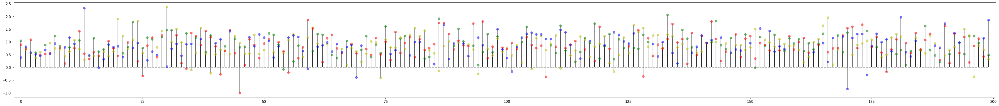

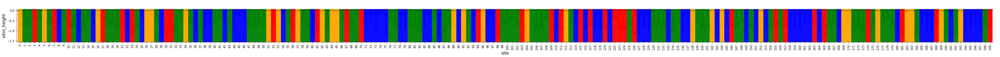

In-silico | ref_pred_lfc: 0.7439 | Effect sum: 4.8039 |


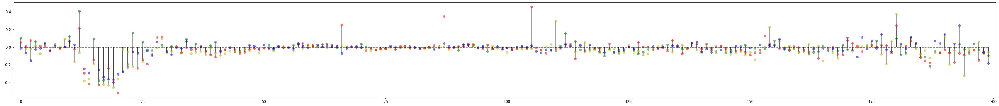

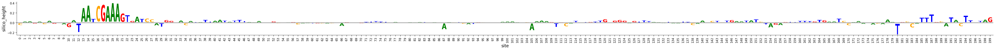

Contribution scores | ref_pred_lfc: 0.7439 | Contribution sum: 1.0734 |


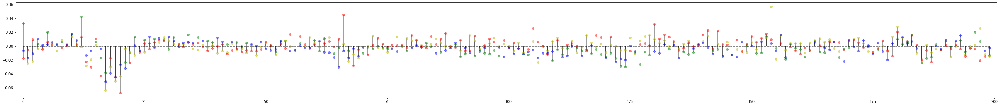

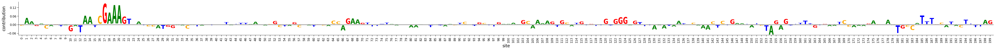



--------------- chr5:87852766-87852966 ---------------

In-vitro | ref_lfc: 0.3435, ref_lfcSE: 0.1754 | Effect sum: 21.1545 |


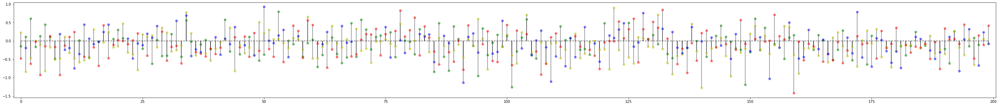

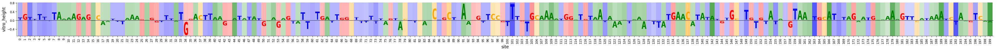

In-silico | ref_pred_lfc: 0.5612 | Effect sum: 1.219 |


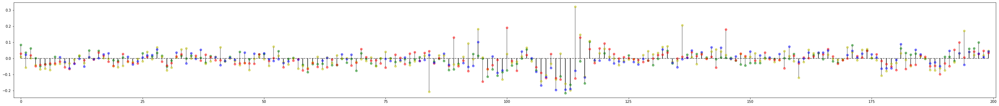

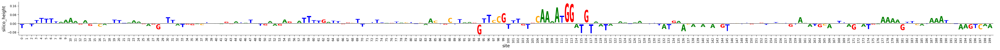

Contribution scores | ref_pred_lfc: 0.5612 | Contribution sum: 0.4042 |


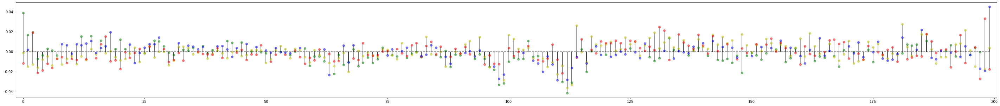

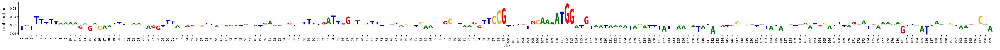



--------------- chr6:136595273-136595473 ---------------

In-vitro | ref_lfc: 1.0814, ref_lfcSE: 0.9527 | Effect sum: 69.0419 |


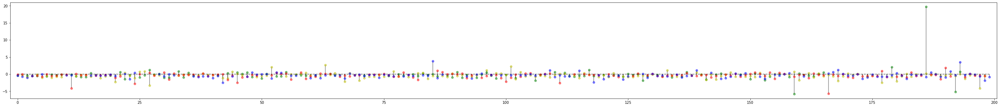

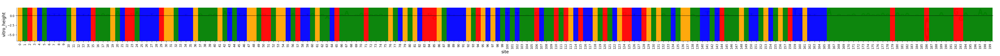

In-silico | ref_pred_lfc: 1.0296 | Effect sum: 0.7978 |


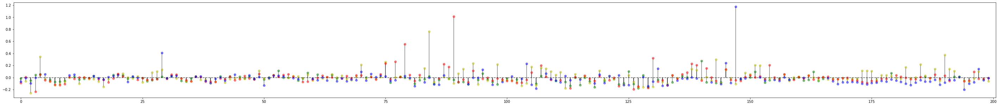

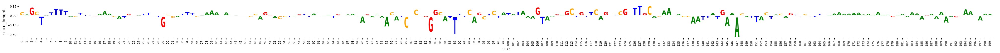

Contribution scores | ref_pred_lfc: 1.0296 | Contribution sum: 2.2072 |


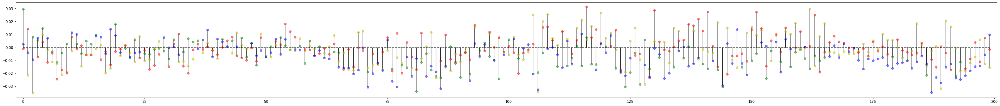

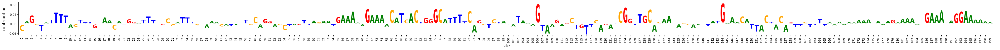



--------------- chr6:14501550-14501750 ---------------

In-vitro | ref_lfc: 1.6493, ref_lfcSE: 0.0976 | Effect sum: 13.4999 |


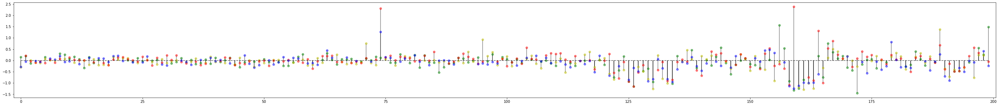

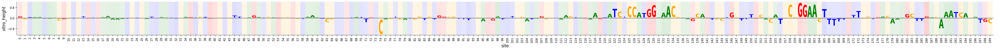

In-silico | ref_pred_lfc: 1.1204 | Effect sum: 4.3741 |


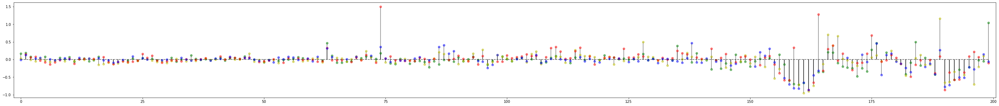

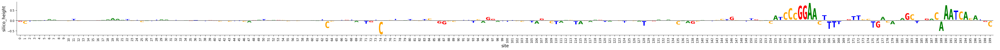

Contribution scores | ref_pred_lfc: 1.1204 | Contribution sum: 3.2263 |


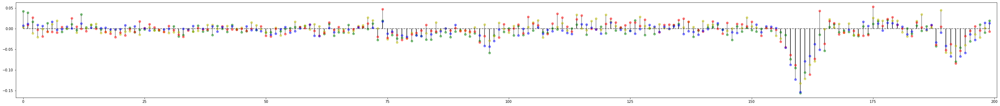

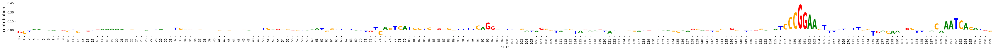



--------------- chr6:91342117-91342317 ---------------

In-vitro | ref_lfc: 0.7317, ref_lfcSE: 0.0809 | Effect sum: -6.6986 |


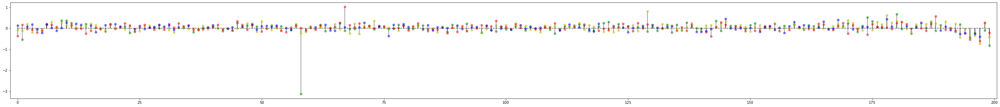

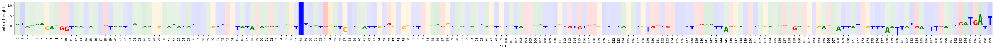

In-silico | ref_pred_lfc: 0.6972 | Effect sum: 2.1902 |


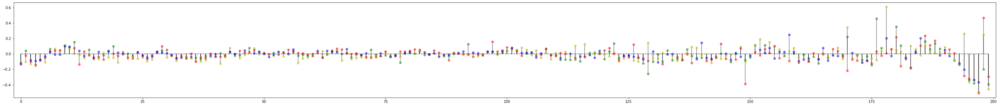

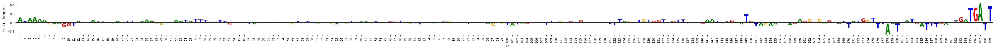

Contribution scores | ref_pred_lfc: 0.6972 | Contribution sum: 0.7494 |


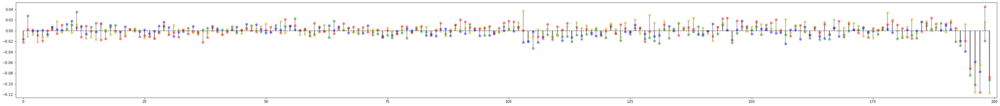

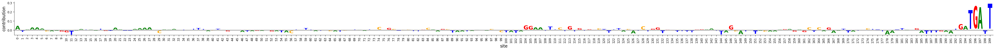



--------------- chr7:100480515-100480715 ---------------

In-vitro | ref_lfc: 0.8965, ref_lfcSE: 0.0773 | Effect sum: 0.765 |


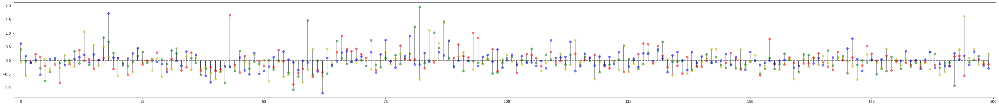

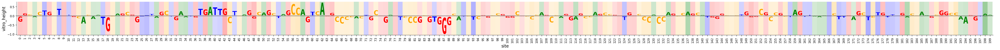

In-silico | ref_pred_lfc: 1.2008 | Effect sum: 6.3857 |


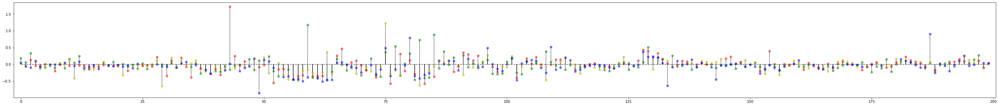

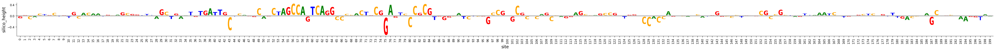

Contribution scores | ref_pred_lfc: 1.2008 | Contribution sum: 1.8761 |


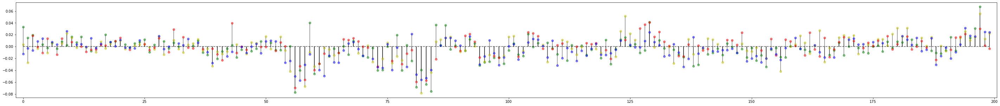

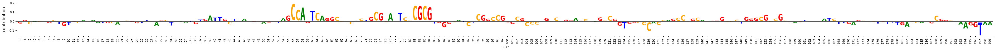



--------------- chr7:114999468-114999668 ---------------

In-vitro | ref_lfc: -0.0764, ref_lfcSE: 0.098 | Effect sum: -5.6746 |


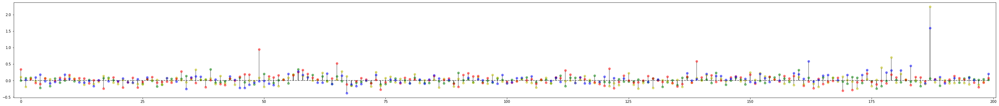

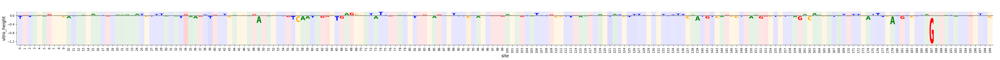

In-silico | ref_pred_lfc: 0.3768 | Effect sum: 5.6901 |


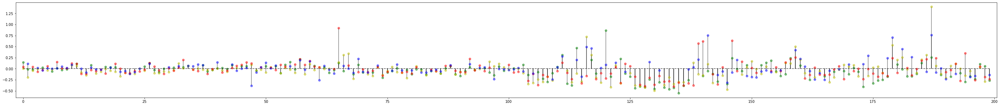

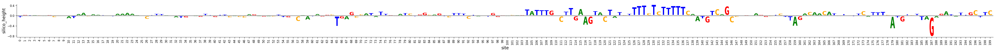

Contribution scores | ref_pred_lfc: 0.3768 | Contribution sum: 1.4992 |


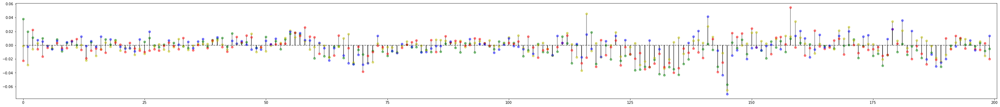

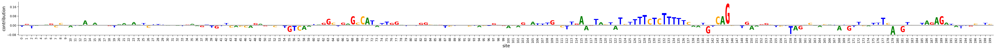



--------------- chr7:114999561-114999761 ---------------

In-vitro | ref_lfc: 1.362, ref_lfcSE: 0.0919 | Effect sum: 20.9925 |


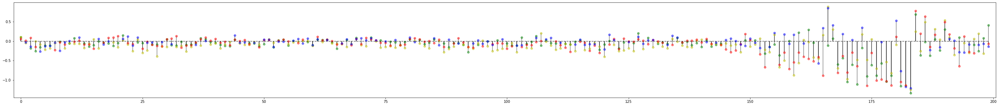

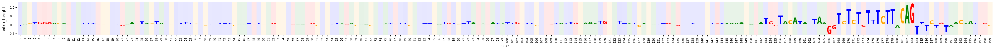

In-silico | ref_pred_lfc: 0.2697 | Effect sum: -0.815 |


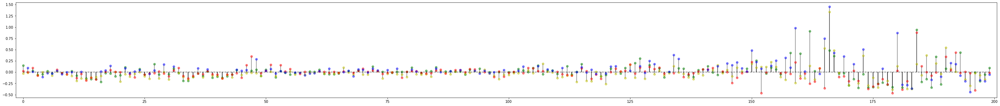

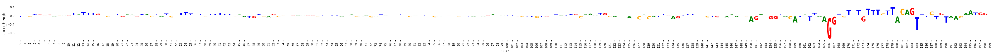

Contribution scores | ref_pred_lfc: 0.2697 | Contribution sum: 1.238 |


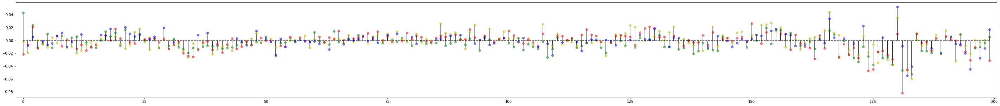

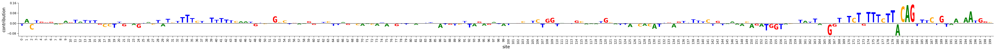

In [32]:
colors=['green','orange','red','blue']

idx_count = 0
for key in effect_tensor_dict.keys():
    decor_print(key)
    tensor_dict = effect_tensor_dict[key]

    ref_sequence = tensor_dict['ref_sequence']
    
    #------------------------------------------ In-vitro ------------------------------------------
    #logo 
    effect_array = tensor_dict['mpra_effect'].numpy()
    effect_means = - effect_array.sum(axis=0) / 3.0
    lfcSE_means = tensor_dict['lfcSE_tensor'].numpy().sum(axis=0) / 3.0   
    
    ref_lfcSE = tensor_dict['ref_lfcSE']
    alphas = np.minimum(np.maximum(lfcSE_means, ref_lfcSE), 0.95)

    temp_data = [list(ref_sequence), effect_means, alphas]
    temp_df = pd.DataFrame(temp_data).transpose()
    temp_df.columns = ['letter', 'vitro_height', 'shade']
    temp_df['color'] = temp_df.apply(lambda x: colors[constants.STANDARD_NT.index(x['letter'])], axis=1)
    temp_df['site'] = temp_df.index
    
    ref_lfc = tensor_dict['ref_lfc']
    effect_total = float(effect_means.sum())
    print(f'In-vitro | ref_lfc: {round(ref_lfc, 4)}, ref_lfcSE: {round(ref_lfcSE, 4)} | Effect sum: {round(effect_total, 4)} |')
    
    #####lollipops#####
    matrix = effect_tensor_dict[key]['mpra_effect'].view(4,-1)
    _ = plot_variant_effects(matrix.numpy())
    #plt.title(f'In-vitro variant effects | {key}')
    plt.show()
    #####lollipops#####
    
    fig, ax = dmslogo.draw_logo(data=temp_df,
                                x_col='site',
                                letter_col='letter',
                                letter_height_col='vitro_height',
                                color_col='color',
                                shade_color_col='color',
                                shade_alpha_col='shade')
    #plt.title(f'In-vitro mean effect sizes | {key}')
    plt.show()
    
    #------------------------------------------ In-silico ------------------------------------------ 
    #logo
    silico_mean_effects = - predicted_saturations[idx_count].sum(dim=0) / 3.0
    temp_df['silico_height'] = silico_mean_effects.numpy()
    
    ref_prediction = float(ref_predictions[idx_count,...])
    silico_effect_total = float(silico_mean_effects.sum())
    print(f'In-silico | ref_pred_lfc: {round(ref_prediction, 4)} | Effect sum: {round(silico_effect_total, 4)} |')
    
    #####lollipops#####
    matrix = predicted_saturations[idx_count].view(4,-1)
    _ = plot_variant_effects(matrix.numpy())
    #plt.title(f'In-silico variant effects | {key}')
    plt.show()
    #####lollipops#####
    
    fig, ax = dmslogo.draw_logo(data=temp_df,
                                x_col='site',
                                letter_col='letter',
                                letter_height_col='silico_height',
                                color_col='color')
    #plt.title(f'In-silico mean effect sizes | {key}')
    plt.show()
    
    
        
    
    #------------------------------------------ Contributions ------------------------------------------
    #logo
    contributions = salient_maps[idx_count,...].detach().sum(dim=0).numpy()
    temp_df['contribution'] = contributions
    contribution_sum = float(contributions.sum())
    
    print(f'Contribution scores | ref_pred_lfc: {round(ref_prediction, 4)} | Contribution sum: {round(contribution_sum, 4)} |')
    
    #####lollipops#####
    ref_tensor = batch_tensor[idx_count,...]
    effect_tensor = (torch.ones_like(ref_tensor) - ref_tensor) * extended_contributions[idx_count,...]
    matrix = effect_tensor.view(4,-1)
    _ = plot_variant_effects(matrix.numpy())
    #plt.title(f'Variant hypothetical contributions | {key}')
    plt.show()
    #####lollipops#####
    
    fig, ax = dmslogo.draw_logo(data=temp_df,
                                x_col='site',
                                letter_col='letter',
                                letter_height_col='contribution',
                                color_col='color')
    #plt.title(f'Contribution scores | {key}')
    plt.show()   
    
    
    print('')
    
    idx_count += 1


--------------- chr14:29859932-29860132 ---------------

In-vitro | ref_lfc: 0.7349, ref_lfcSE: 0.0918 |


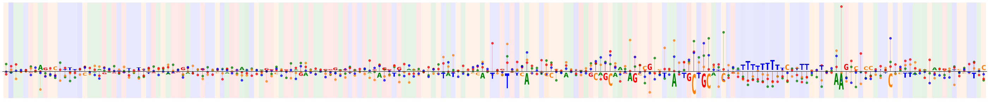

In-silico | ref_pred_lfc: 1.0003 |


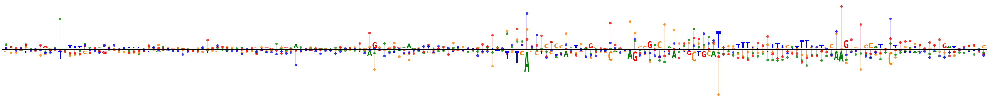

Contribution scores | ref_pred_lfc: 1.0003 |


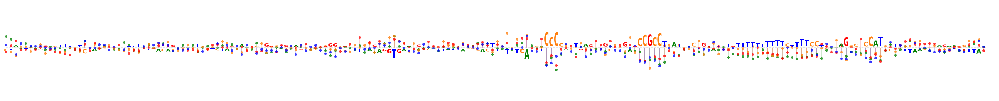


--------------- chr14:37559109-37559309 ---------------

In-vitro | ref_lfc: -0.2037, ref_lfcSE: 0.0615 |


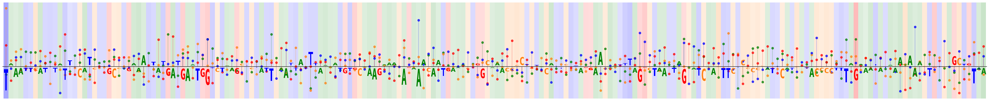

In-silico | ref_pred_lfc: -0.1531 |


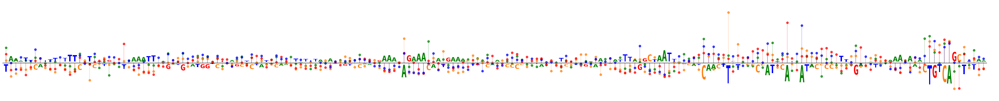

Contribution scores | ref_pred_lfc: -0.1531 |


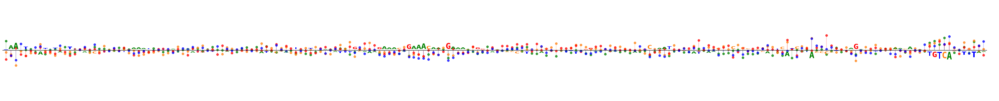


--------------- chr14:57553315-57553515 ---------------

In-vitro | ref_lfc: 0.8462, ref_lfcSE: 0.1354 |


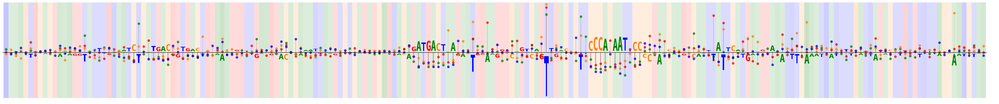

In-silico | ref_pred_lfc: 1.5192 |


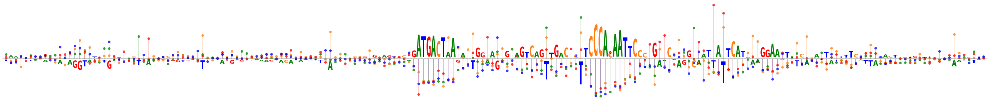

Contribution scores | ref_pred_lfc: 1.5192 |


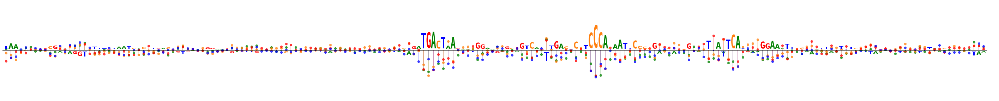


--------------- chr17:2095085-2095285 ---------------

In-vitro | ref_lfc: 1.2781, ref_lfcSE: 0.0712 |


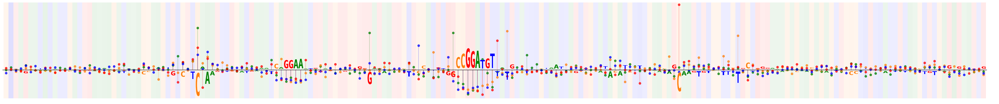

In-silico | ref_pred_lfc: 0.894 |


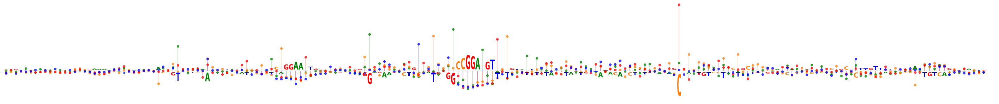

Contribution scores | ref_pred_lfc: 0.894 |


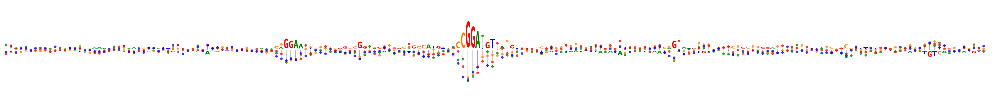


--------------- chr17:2095258-2095458 ---------------

In-vitro | ref_lfc: 1.9521, ref_lfcSE: 0.0806 |


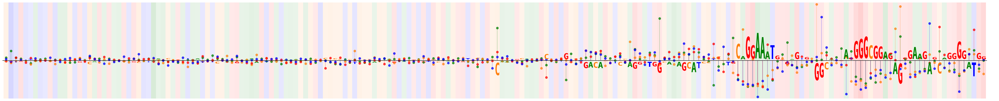

In-silico | ref_pred_lfc: 1.7146 |


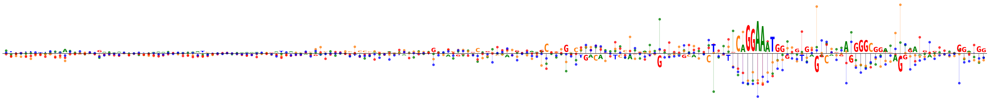

Contribution scores | ref_pred_lfc: 1.7146 |


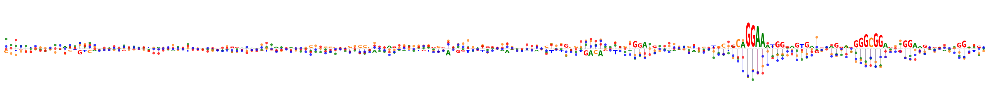


--------------- chr19:30843409-30843609 ---------------

In-vitro | ref_lfc: 0.2133, ref_lfcSE: 0.1441 |


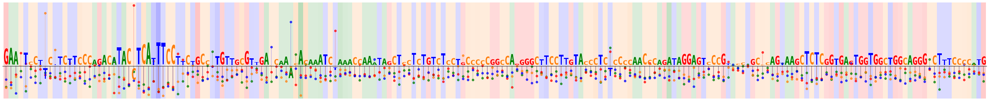

In-silico | ref_pred_lfc: -0.2243 |


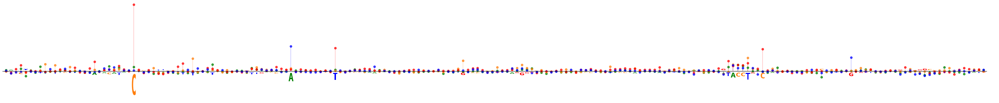

Contribution scores | ref_pred_lfc: -0.2243 |


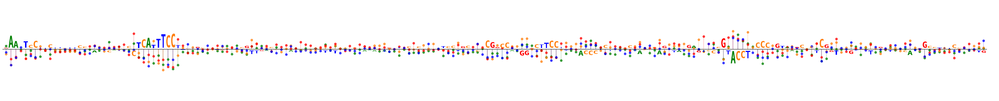


--------------- chr1:47041104-47041304 ---------------

In-vitro | ref_lfc: 0.3866, ref_lfcSE: 0.2172 |


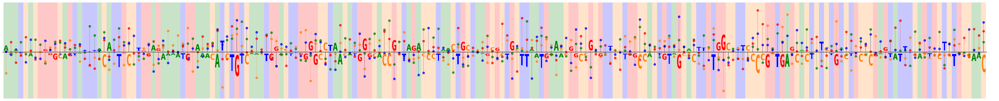

In-silico | ref_pred_lfc: 1.031 |


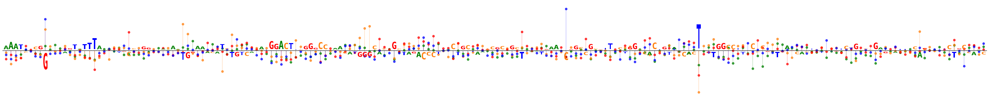

Contribution scores | ref_pred_lfc: 1.031 |


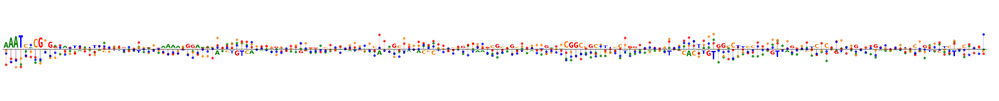


--------------- chr1:90847872-90848072 ---------------

In-vitro | ref_lfc: -0.0841, ref_lfcSE: 0.0918 |


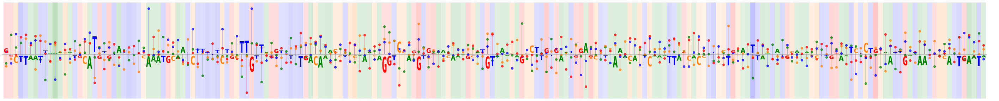

In-silico | ref_pred_lfc: -0.1275 |


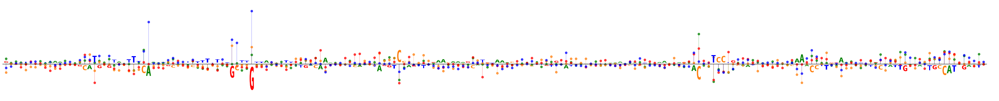

Contribution scores | ref_pred_lfc: -0.1275 |


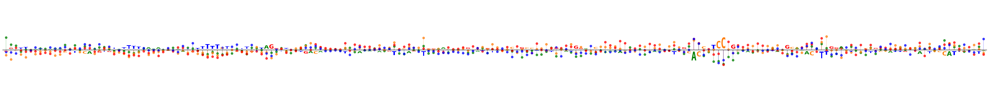


--------------- chr2:60077721-60077921 ---------------

In-vitro | ref_lfc: -0.5163, ref_lfcSE: 0.068 |


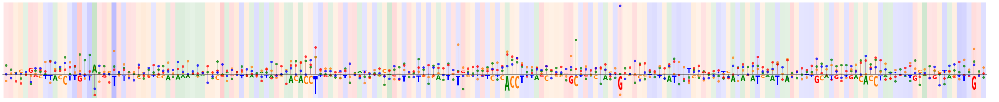

In-silico | ref_pred_lfc: -0.3823 |


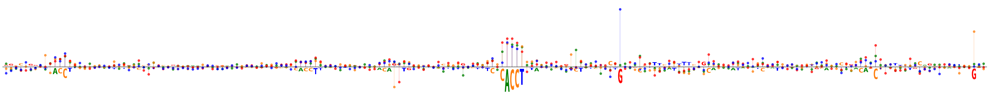

Contribution scores | ref_pred_lfc: -0.3823 |


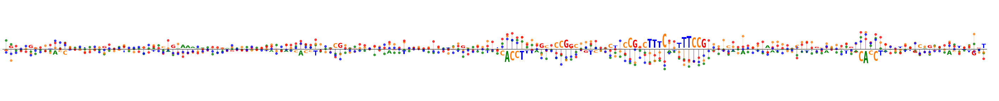


--------------- chr3:136760181-136760381 ---------------

In-vitro | ref_lfc: 0.195, ref_lfcSE: 0.1069 |


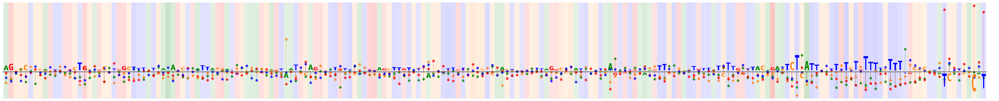

In-silico | ref_pred_lfc: 0.3062 |


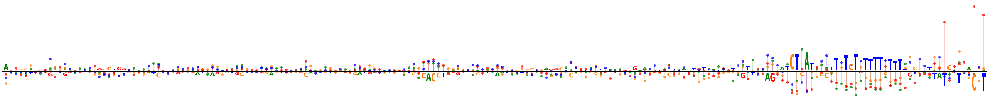

Contribution scores | ref_pred_lfc: 0.3062 |


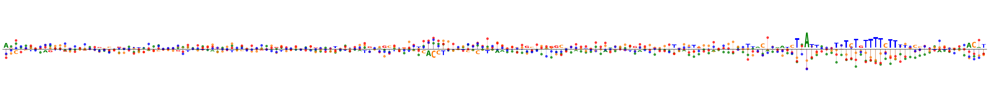


--------------- chr3:19028436-19028636 ---------------

In-vitro | ref_lfc: 0.4588, ref_lfcSE: 0.1109 |


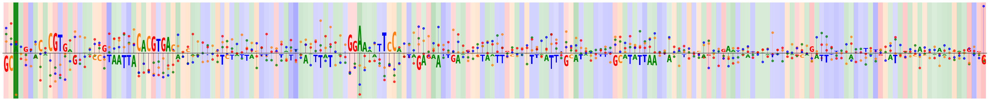

In-silico | ref_pred_lfc: 0.6211 |


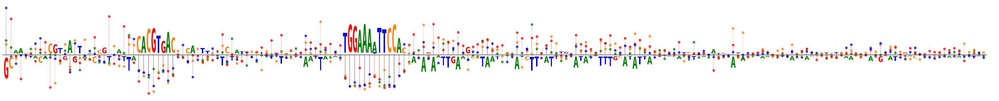

Contribution scores | ref_pred_lfc: 0.6211 |


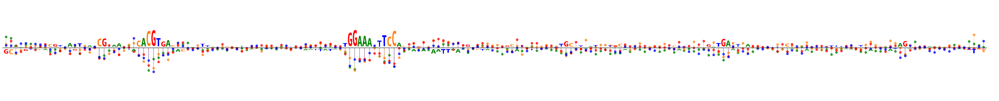


--------------- chr4:147215670-147215870 ---------------

In-vitro | ref_lfc: -0.6131, ref_lfcSE: 1.2738 |


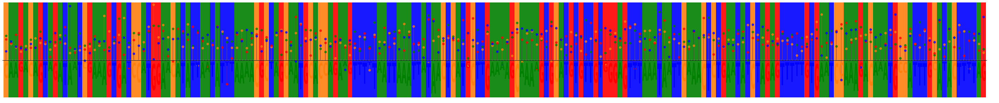

In-silico | ref_pred_lfc: 0.7439 |


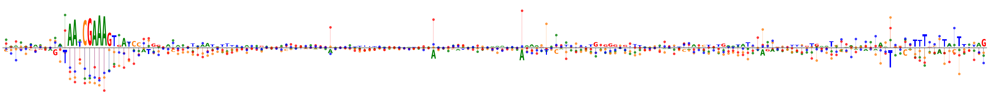

Contribution scores | ref_pred_lfc: 0.7439 |


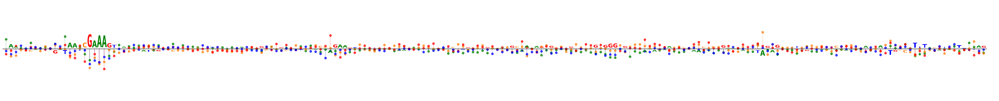


--------------- chr5:87852766-87852966 ---------------

In-vitro | ref_lfc: 0.3435, ref_lfcSE: 0.1754 |


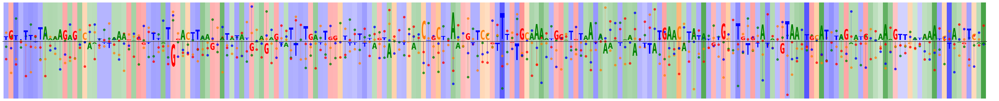

In-silico | ref_pred_lfc: 0.5612 |


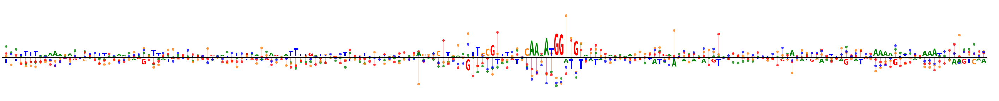

Contribution scores | ref_pred_lfc: 0.5612 |


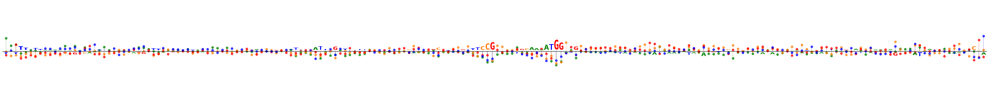


--------------- chr6:136595273-136595473 ---------------

In-vitro | ref_lfc: 1.0814, ref_lfcSE: 0.9527 |


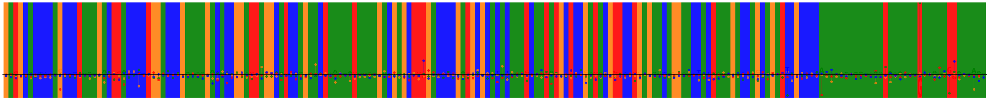

In-silico | ref_pred_lfc: 1.0296 |


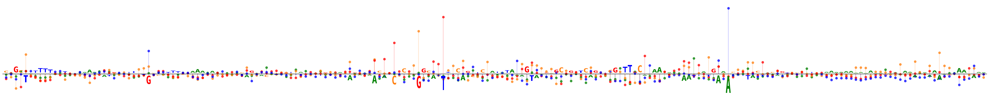

Contribution scores | ref_pred_lfc: 1.0296 |


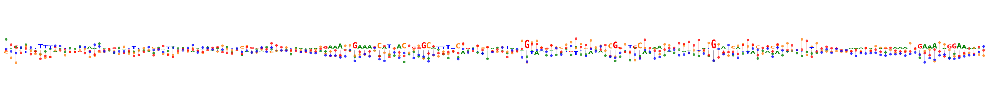


--------------- chr6:14501550-14501750 ---------------

In-vitro | ref_lfc: 1.6493, ref_lfcSE: 0.0976 |


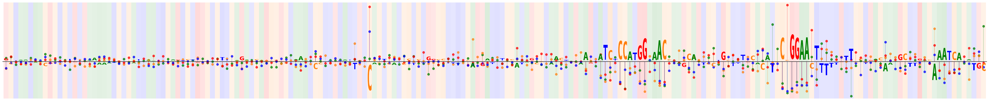

In-silico | ref_pred_lfc: 1.1204 |


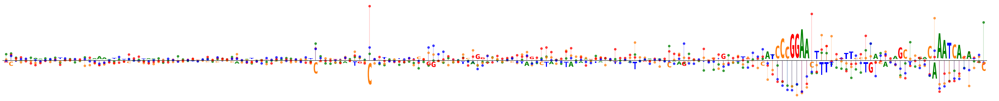

Contribution scores | ref_pred_lfc: 1.1204 |


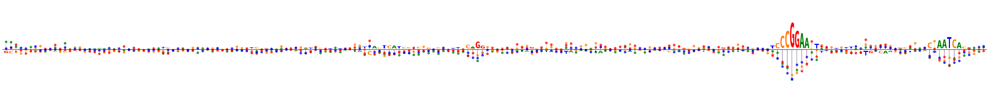


--------------- chr6:91342117-91342317 ---------------

In-vitro | ref_lfc: 0.7317, ref_lfcSE: 0.0809 |


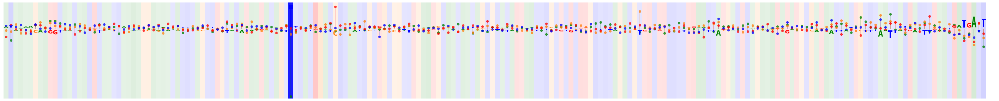

In-silico | ref_pred_lfc: 0.6972 |


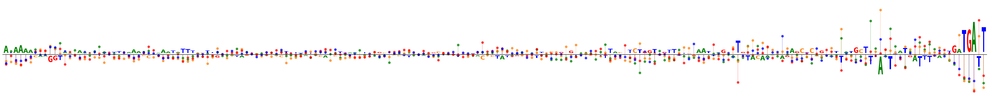

Contribution scores | ref_pred_lfc: 0.6972 |


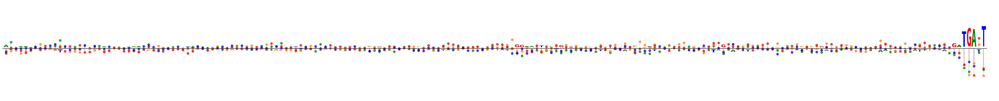


--------------- chr7:100480515-100480715 ---------------

In-vitro | ref_lfc: 0.8965, ref_lfcSE: 0.0773 |


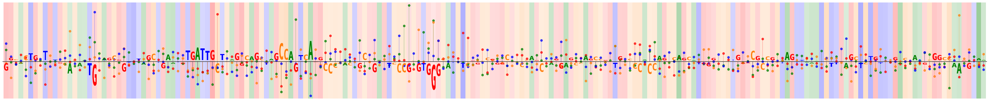

In-silico | ref_pred_lfc: 1.2008 |


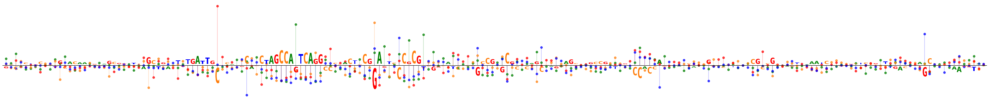

Contribution scores | ref_pred_lfc: 1.2008 |


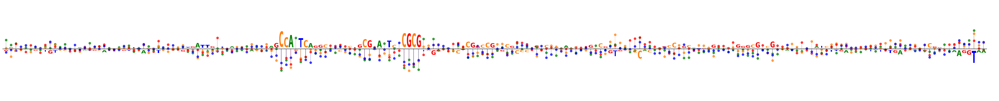


--------------- chr7:114999468-114999668 ---------------

In-vitro | ref_lfc: -0.0764, ref_lfcSE: 0.098 |


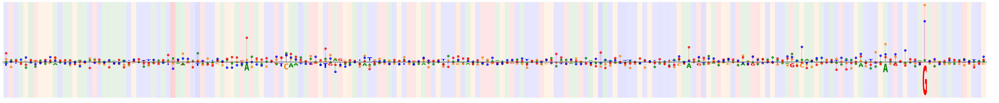

In-silico | ref_pred_lfc: 0.3768 |


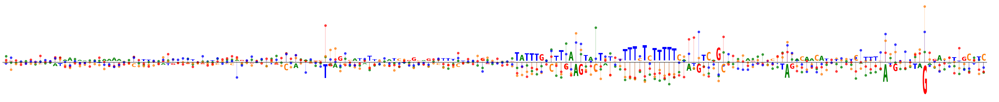

Contribution scores | ref_pred_lfc: 0.3768 |


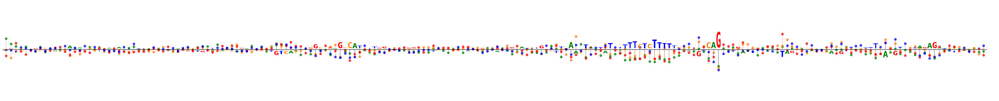


--------------- chr7:114999561-114999761 ---------------

In-vitro | ref_lfc: 1.362, ref_lfcSE: 0.0919 |


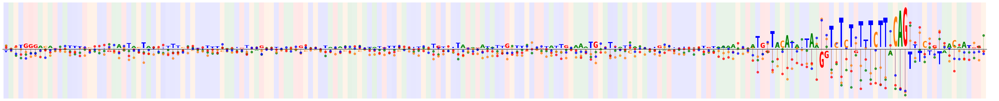

In-silico | ref_pred_lfc: 0.2697 |


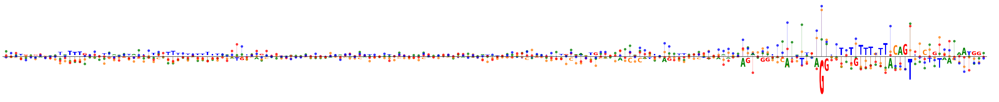

Contribution scores | ref_pred_lfc: 0.2697 |


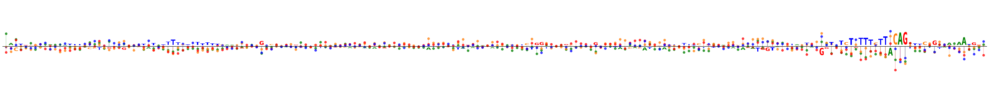

In [158]:
idx_count = 0
for key in effect_tensor_dict.keys():
    decor_print(key)
    
    tensor_dict = effect_tensor_dict[key]
    ref_sequence = tensor_dict['ref_sequence']
    effect_array = tensor_dict['mpra_effect'].numpy()
    lfcSE_array = tensor_dict['lfcSE_tensor'].numpy()
    ref_lfc = tensor_dict['ref_lfc']
    ref_lfcSE = tensor_dict['ref_lfcSE']
    
    pred_effect_array = predicted_saturations[idx_count].detach().numpy()
    contributions_array = extended_contributions[idx_count,...].numpy()
    
    print(f'In-vitro | ref_lfc: {round(ref_lfc, 4)}, ref_lfcSE: {round(ref_lfcSE, 4)} |')
    plot_satmut(ref_sequence, effect_array, lfcSE_array, ref_lfcSE, marker_alpha=0.75, stem_alpha=0.25, linestyle='solid') 
    
    ref_prediction = float(ref_predictions[idx_count,...])
    print(f'In-silico | ref_pred_lfc: {round(ref_prediction, 4)} |')
    plot_satmut(ref_sequence, pred_effect_array, marker_alpha=0.75, stem_alpha=0.25, linestyle='solid')
    
    print(f'Contribution scores | ref_pred_lfc: {round(ref_prediction, 4)} |')
    plot_complete_contributions(ref_sequence, contributions_array, marker_alpha=0.75, stem_alpha=0.25, linestyle='solid')
    
    idx_count += 1